<a href="https://colab.research.google.com/github/lielserfaty/Data-Mining-course-project/blob/main/TEST_data_mining.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TEST A - 2022 - Data Mining


```
Submitted by - 312350622
```



# Question 1 - Pennsylvania & Philadelphia


In [ ]:
! pip install tweepy
!pip install pyyaml==5.4.1
! pip install tweepy --upgrade
! pip install GoogleNews
! pip install newspaper3k
! pip install turicreate
! pip install afinn
! pip install kaggle
! python -m spacy download en_core_web_lg
! pip install cupy-cuda111
! pip install spacy-transformers # we need to install this package before using the transformes models
! python -m spacy download en_trf_bertbaseuncased_lg
! python -m spacy download en_core_web_trf
! pip install cupy-cuda117
! pip install --upgrade numpy


In [ ]:
import tweepy
import pandas as pd
from GoogleNews import GoogleNews
import nltk
nltk.download('punkt')
from newspaper import Article
from newspaper import Config
from afinn import Afinn
import turicreate as tc
import spacy
import operator
import seaborn as sns
import datetime as dt
import matplotlib as plt
from collections import Counter
from nltk import word_tokenize
from nltk.corpus import stopwords
import matplotlib.pyplot as plt
from nltk.stem.porter import *
import nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.stem import WordNetLemmatizer
nltk.download('wordnet')
nltk.download('omw-1.4')
import json
import numpy as np
import gensim.downloader as api
from wordcloud import WordCloud
import folium
%matplotlib inline
from folium.plugins import HeatMap
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="Data Science Education App") #  Using OpenStreetMap Nominatim
from functools import lru_cache
from scipy.interpolate import interp1d # for transfaering font size
import time

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


In [ ]:
api_token = {"username":"lielserfaty","key":"sshhh!!"}
!mkdir /root/.kaggle/
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
!mkdir ./Qeustion_1
!mkdir ./Qeustion_1/database

!kaggle datasets download -d nicolemichelle/abortion-ban-twitter-dataset -p ./Question_1/database/
!unzip ./Question_1/database/*.zip  -d ./Question_1/database/

## 1.1 - News
Pennsylvania is known as a state that does not ban abortions. Therefore, we would like to see if the attitude there changes, if there is an influx of women who want to abort towards Pennsylvania, and if the ruling has led to protests and demonstrations.

We will divide the task into three parts:

1. **Collection of information** - We will collect information about what is happening in these countries since the Supreme Court ruling. We will collect news articles that have been published since the ruling with the help of Google News.
2. We would like to analyze the amount of news over time, and perform analyzes on the text.
* Ideally we would like to categorize each article as to whether it supports abortions or opposes. But such articles tend to be neutral and only describe what is going on. We will only use sentinment analysis to try to understand whether the text expresses negative or positive emotions.
* We would like to identify events that have taken place - demonstrations, protests, appeals. And therefore was asked to train a model that recognizes events within a text (I searched and did not find a model trained for this). We do this by identifying keywords, such as "violence", "demonstration", "protest", "appeal" and more. This way we can extract key sentences from the text and display them on the timeline.
* We will present a heat map according to places that have appeared in the articles. I would like to identify specific locations within Pennsylvania (e.g. "protest in front of City Hall") but the entity identifier failed to do so. We will therefore mainly represent countries, so that countries mentioned more often will be displayed in "warmer" colors.
* We will focus on Pennsylvania and Philadelphia itself and present the article titles by location on the area map.

3. View the maps, graphs and events along the timeline.

### Data Mining

From Google-News

In [ ]:
# search on google-news - only english, since 24/6
news = GoogleNews(start='24/06/2022', lang='en', region='US', encode='utf-8')

In [ ]:
# query:
news.search("abortions philadelphia")  # and then Pennsylvania

# search:
result = news.result()
news_df = pd.DataFrame.from_dict(result)
news_df = news_df.drop(columns=["img"])

# search also in the next 4 pages:
for page in range(2,6):
  result = news.page_at(page)
  tmp_df = pd.DataFrame.from_dict(result)
  news_df = pd.concat([news_df, tmp_df], ignore_index=True)

news_df.head(30)

,title,media,date,datetime,desc,link,img
0,A Nation Reacts to Abortion Rights Rollbacks,Philadelphia Weekly,2 hours ago,2022-07-06 12:31:22.737304,"In a move that was forecast by a leak, the Sup...",https://philadelphiaweekly.com/a-nation-reacts...,NaN
1,Judge Won't Block Law Banning Most Mississippi...,NBC10 Philadelphia,13 hours ago,2022-07-06 01:31:22.739473,A Mississippi judge has rejected a request by ...,https://www.nbcphiladelphia.com/news/national-...,NaN
2,"In Rural West, More Worries About Access to Ab...",NBC10 Philadelphia,1 day ago,2022-07-05 14:31:22.741575,"Across the U.S. West, rural residents have his...",https://www.nbcphiladelphia.com/news/national-...,NaN
3,Abortion rights supporters hold series of prot...,Audacy,1 day ago,2022-07-05 14:31:22.743585,Abortion rights advocates in Philadelphia mark...,https://www.audacy.com/kywnewsradio/news/local...,NaN
4,Philadelphians Rally For Abortion Rights At In...,CBS Philly,1 day ago,2022-07-05 14:31:22.745611,"PHILADELPHIA (CBS) — On Independence Mall, abo...",https://philadelphia.cbslocal.com/2022/07/04/i...,NaN
5,July Fourth abortion protests in Philadelphia:...,Billy Penn,3 days ago,2022-07-03 14:31:22.747747,After the Supreme Court overturned Roe. v. Wad...,https://billypenn.com/2022/07/03/july-fourth-a...,NaN
6,Texas Supreme Court Blocks Order Allowing Abor...,NBC10 Philadelphia,3 days ago,2022-07-03 14:31:22.749856,The Texas Supreme Court has blocked a lower co...,https://www.nbcphiladelphia.com/news/national-...,NaN
7,Texas Supreme Court Blocks Order That Resumed ...,NBC10 Philadelphia,4 days ago,2022-07-02 14:31:22.751912,The Texas Supreme Court blocked a lower court ...,https://www.nbcphiladelphia.com/news/national-...,NaN
8,"With Western PA Abortion Clinics Overwhelmed, ...",Philadelphia Magazine,4 days ago,2022-07-02 14:31:22.753859,In the days since the Supreme Court's reversal...,https://www.phillymag.com/news/2022/07/01/phil...,NaN
9,"Post-Roe Abortion Laws Leave Patients, Clinics...",NBC10 Philadelphia,4 days ago,2022-07-02 14:31:22.755812,The evolving legal landscape around abortion a...,https://www.nbcphiladelphia.com/news/national-...,NaN


In [ ]:
# get content and parser

def get_text_operations(url):
  # configurations:
  user_agent = 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; rv:78.0) Gecko/20100101 Firefox/78.0'
  config = Config()
  config.browser_user_agent = user_agent
  config.request_timeout = 80
  if 'abc23' in url:
    return None, None, None
  # download:
  url = url['link']
  article = Article(url, config=config)
  try:
    article.download()
    article.parse()
  except:
    return None, None, None
  # parser & nlp
  txt = article.text
  article.nlp()
  key_words = article.keywords
  summary = article.summary

  return txt, key_words, summary

news_df[['full_txt', 'keywords', 'summary']] = news_df[['link']].apply(get_text_operations, axis=1, result_type='expand')


In [ ]:
news_penn = news_df.copy()

In [ ]:
news_df = pd.concat([news_df, news_penn], ignore_index=True)

### Analysis

**sentiment:**

In [ ]:
# add afinn score to each text of news
afinn = Afinn()
news_sf['afinn_score'] = news_sf['full_txt'].apply(lambda t: afinn.score(t))

def afinn2sentiment(score):
    return 'positive' if score > 0 else 'negative' if score < 0 else 'neutral'
news_sf['sentinment'] = news_sf['afinn_score'].apply(lambda label: afinn2sentiment(label))

In [ ]:
# extract the date from datetime
def get_year(t):
  return t[:4]
def get_month(t):
  return t[5:7]
def get_day(t):
  return t[8:10]
def get_days_before(t):
  return int(t.split(" ")[0])

news_sf['year'] = news_sf['datetime'].apply(get_year)
news_sf['month'] = news_sf['datetime'].apply(get_month)
news_sf['day'] = news_sf['datetime'].apply(get_day)
news_sf['days_before'] = news_sf['date'].apply(get_days_before)
news_sf

**events:**

In [ ]:
lemmatizer = WordNetLemmatizer()

# list of words that describe a protests
list_of_events = ['Demonstrations', 'protests', 'violence', 'shouting', 'appeal', 'organization', 'organizing']
list_of_events = [lemmatizer.lemmatize(w) for w in list_of_events]


# find text conatin that words
def find_event(txt):
    words = word_tokenize(txt)
    words = [lemmatizer.lemmatize(w) for w in words]
    words = [w for w in words if w in list_of_events]
    if len(words) != 0:
        return words
    return []

In [ ]:
# add list of protests words to each text
l = []
for i in range(len(news_sf)):
  txt = news_sf[i]['full_txt']
  l.append(find_event(txt))
news_sf['events'] = l

In [ ]:
# dropna
news_sf = news_sf.to_dataframe()
news_sf_event = news_sf[news_sf['events'].map(len) > 0]

In [ ]:
# stack
news_sf_event_satck = news_sf_event.explode('events').reset_index(drop=True)

In [ ]:
# split the date
news_sf_event_satck['date_column'] = pd.to_datetime(news_sf_event_satck['datetime']).dt.date

**locations:**

In [ ]:
nlp = spacy.load('en_core_web_lg')

def get_locations_from_text(text):
    locations_lst = []

    #using spaCy to get entities
    doc = nlp(text)

    for entity in doc.ents:
        label = entity.label_
        if label not in {'LOC', 'GPE'}:
            continue
        loc = entity.text.lower().strip()
        if len(loc) < 2:
            continue
        if loc not in locations_lst:
            locations_lst.append(loc)
    return locations_lst
#loc = []
for i in range(50,100):
  loc.append(get_locations_from_text(news_sf[i]['full_txt']))
#news_sf['location'] = news_sf['full_txt'].apply(get_locations_from_text)

In [ ]:
news_sf_loc = news_sf.add_column(loc, 'locations')

In [ ]:
news_sf_loc = news_sf_loc.to_dataframe()
news_sf_loc = news_sf_loc[news_sf_loc['locations'].map(len) > 0]
news_sf_loc = news_sf_loc[['title', 'datetime', 'link', 'locations']]

### Result

**Sentiment Analysis:**

Text(0.5, 1.0, 'The number of news articles published on the subject since the Supreme Court ruling, classified by sentinment')

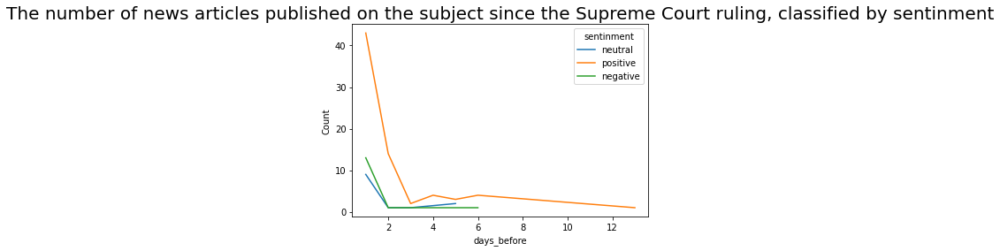

In [ ]:
# groupby date
news_date = news_sf.groupby(['days_before', 'sentinment'], tc.aggregate.COUNT())
news_date
news_date = news_date.to_dataframe()

fig = sns.lineplot(data=news_date, x="days_before", y="Count", hue="sentinment")
fig.axes.set_title("The number of news articles published on the subject since the Supreme Court ruling, classified by sentinment",fontsize=20)

**Events:**

The following figure shows the events that occurred along the timeline. It can be seen that there are many news articles that described protest especially in the days following the Supreme Court ruling. More details and a link to the article - hover over the point

In [ ]:
news_sf_event_satck['lengt'] = news_sf_event_satck['title'].str.len()
news_sf_event_satck['date_str']=news_sf_event_satck['date_column'].astype(str)

In [ ]:
import plotly.express as px

fig = px.scatter(news_sf_event_satck, x="date_str", y="lengt", size="lengt", color="events",
           hover_name="title",  hover_data=["link"], size_max=30, title="Events on Time")
fig.show()

Maps:

In [ ]:
# find loaction coordinate by name
@lru_cache(maxsize=256)
def get_location(loc):
    time.sleep(1)
    return geolocator.geocode(loc)

In [ ]:
# run the above function and save in dict
def get_coordinates_of_loc(locations):
  locations_dict = {}
  for loc in locations:
    try:
      location = get_location(loc)
      locations_dict[loc] = (location.longitude, location.latitude)
    except:
      continue
  return locations_dict

In [ ]:
# read the df with the location found on each paper
from ast import literal_eval
df = pd.read_csv('./03-news_with_loc.csv',converters={"locations": literal_eval})
df = df.explode('locations').reset_index(drop=True)
df

In [ ]:
# create dict map location to coordinates
loc_dict = get_coordinates_of_loc(df['locations'].unique())

In [ ]:
# delete USA
to_del = ['us', 'america', 'the united states', 'u.s.']
for d in to_del:
  del loc_dict[d]

In [ ]:
# run this create df map loc to longitude and latitude and count the times the location appears
dic_to_df = {'loc': [], 'longitude': [], 'latitude': [], 'count':[]}
values = df['locations'].value_counts(dropna=False).keys().tolist()
counts = df['locations'].value_counts(dropna=False).tolist()
value_dict = dict(zip(values, counts))

for k in value_dict.keys():
  if k in loc_dict:
    dic_to_df['loc'].append(k)
    dic_to_df['longitude'].append(loc_dict[k][0])
    dic_to_df['latitude'].append(loc_dict[k][1])
    dic_to_df['count'].append(value_dict[k])
df_loc = pd.DataFrame.from_dict(dic_to_df)
df_loc

,loc,longitude,latitude,count
0,pennsylvania,-77.727883,40.969989,58
1,philadelphia,-75.163526,39.952724,46
2,ohio,-82.688140,40.225357,24
3,new jersey,-74.404162,40.075738,23
4,texas,-98.545612,31.263890,19
...,...,...,...,...
201,iran,54.564352,32.647531,1
202,nicaragua,-85.293691,12.609016,1
203,honduras,-86.075514,15.257243,1
204,uruguay,-56.020153,-32.875555,1


In [ ]:
sf = tc.SFrame(df_loc)
tiles = 'Stamen Terrain'
m = folium.Map(location=[0,0], zoom_start=2,
               tiles = tiles)

data = [(r['latitude'],r['longitude'],r['count']) for r in sf]
HeatMap(data, radius = 20).add_to(m)
m

As you can see, a massive number of articles include places around Pennsylvania, as expected.

We will now focus on Pennsylvania itself:

In [ ]:
# merge loaction and news
sf_news = tc.SFrame(df)
sf.rename({'loc': 'locations'}, inplace=True)
sf = sf.join(sf_news, how='left', on='locations')
sf.export_csv("./map.csv")

In [ ]:
# NOTE! it's can take a while to load the map view and output cell
m = folium.Map(location=[40,-76], zoom_start=8) #  Latitude and Longitude (Northing, Easting)
for r in sf:
  try:
    latitude = r['longitude']
    longitude = r['latitude']
    if ((longitude < 37.9) | (longitude > 41.6) | (latitude < -77.8) | (latitude > -74.7)):

      continue
  except:
    continue


  details = f"Title: {r['title']}" + f"\nlink: {r['link']}"

  folium.Marker(
      location=[longitude, latitude], # coordinates for the marker (Earth Lab at CU Boulder)
      popup=details, # pop-up label for the marker
      icon=folium.Icon(color='red', icon='info-sign')
  ).add_to(m)
m



## 1.2 - Twitter
We will now move on to collecting tweets from Twitter.
1. To identify tweets related to the Supreme Court ruling and the impact on Pennsylvania (and Philadelphia), we will use a search within Twitter, and a collection of posts that contain the keywords and were published after the court decision. Note: in an ideal situation I would like to scratch only the tweets posted in Pennsylvania itself or that actually describe things that happened in it. But using the location in the query on Twitter results in very few tweets (because not every tweet has information about the place), and other packages required a license that takes a few days to issue (I submitted an unanswered request).
2. We would like to classify the information into tweets that support the decision and those against. We will therefore use a classification model for this purpose (detailed below).
* We would like to introduce the topic of each group. But it may lead to similar issues (since dealing with the same issues - abortions in Pennsylvania) so we will do this by identifying the main words in each group (also may lead to a large overlap).
* Let’s take a look at the connection between the type of tweet and the emotion expressed on Twitter. This is done through sentinment analysis.
* We will analyze the correlation with the number of followers of the user in posting the tweet.
* Finally, we will perform topic modeling to identify the topics of each group, but again, this may lead to a large overlap.

3. We will present the results

### Data Mining

In [ ]:
client = tweepy.Client(bearer_token='# I delete before submission')

# Get tweets that contain the words: "Pennsylvania" and "abortions"
# lang:en is asking for the tweets to be in english
query_penn = 'Pennsylvania abortions lang:en'
query_phi = 'Philadelphia abortions lang:en'

# run both queries
tweets_penn = client.search_recent_tweets(query=query_penn,  expansions=['author_id'], max_results=100, tweet_fields=['author_id','context_annotations','created_at','entities','geo'], user_fields=['username','location','verified','public_metrics'])
tweets_phi = client.search_recent_tweets(query=query_phi,  expansions=['author_id'], max_results=100, tweet_fields=['author_id','context_annotations','created_at','entities','geo'], user_fields=['username','location','verified','public_metrics'])

tweets_copy = []
for tweet in tweets_penn.data:
    tweets_copy.append(tweet)
for tweet in tweets_phi.data:
    tweets_copy.append(tweet)

In [ ]:
# create df of user whom published the collected tweets
users_copy = []
for usr in tweets_penn.includes['users']:
    users_copy.append(usr)
for usr in tweets_phi.includes['users']:
    users_copy.append(usr)

users_df = pd.DataFrame()
# populate the dataframe
for u in users_copy:

    users_df = users_df.append(pd.DataFrame({'user_id': u.id,
                                               'user_name': u.username,
                                               'user_location': u.location,
                                               'user_verified': u.verified,
                                               'user_followers': u.public_metrics
                                            }))
    users_df = users_df.reset_index(drop=True)
# show the dataframe
users_df.head()

,user_id,user_name,user_location,user_verified,user_followers
0,1499400541083865091,ChrisHi51522115,None,False,11
1,1499400541083865091,ChrisHi51522115,None,False,48
2,1499400541083865091,ChrisHi51522115,None,False,0
3,1499400541083865091,ChrisHi51522115,None,False,2039
4,540993697,meJust98492191,Meow Island,False,610


In [ ]:
# create df of tweets
tweets_df = pd.DataFrame()
# populate the dataframe
for tweet in tweets_copy:
    hashtags = []
    try:
        for hashtag in tweet.entities["hashtags"]:
            hashtags.append(hashtag["tag"])
    except:
        pass
    tweets_df = tweets_df.append(pd.DataFrame({'tweet_id': tweet.id,
                                               'user_id': tweet.author_id,
                                               'date': tweet.created_at,
                                               'text': tweet.text,
                                               'hashtags': [hashtags if hashtags else None],
                                               'source': tweet.source}))
    tweets_df = tweets_df.reset_index(drop=True)
# show the dataframe
tweets_df.head()

,tweet_id,user_id,date,text,hashtags,source
0,1544684319607820288,1499400541083865091,2022-07-06 14:06:55+00:00,@America1Scotty In my state of Pennsylvania th...,None,None
1,1544521273115660290,540993697,2022-07-06 03:19:01+00:00,#Pennsylvania vote for @JoshShapiroPA we know ...,"[Pennsylvania, ABORTIONS, WomensRights, transr...",None
2,1544515007844581376,1180159675712581642,2022-07-06 02:54:08+00:00,RT @Lost_Loyalist: @SonyaMetzger2 @Kimmiemac21...,None,None
3,1544514861358632967,3224469135,2022-07-06 02:53:33+00:00,@SonyaMetzger2 @Kimmiemac21 @dougmastriano @Jo...,None,None
4,1544508308966572034,1650861697,2022-07-06 02:27:31+00:00,RT @TracyConnor: “There’s a bunch of family me...,None,None


### Analysis

To know if the tweet is for or against the Supreme Court ruling, we will use [data from kaggle](https://www.kaggle.com/datasets/nicolemichelle/abortion-ban-twitter-dataset) that classifies tweets to support or doen't support the decision. Because the data set is relatively small, we will run several nlp operations on it to extract as much information as possible. We will do the same process on the tweets we collected.
We will build the classification first, and then we will use its to classify our tweets.

In [ ]:
# load kaggle and our tweets
tw_sf = tc.SFrame.read_csv('./tweet_penn_phi.csv')
user_sf = tc.SFrame.read_csv('./user_penn_phi.csv')
kaggle_sf = tc.SFrame.read_csv('./Question_1/database/trainset.csv')
kaggle_sf = kaggle_sf[['text', 'hashtags', 'Type']]

Read 100 lines. Lines per second: 5388.51

Finished parsing file /content/tweet_penn_phi.csv

Parsing completed. Parsed 100 lines in 0.018684 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,int,int,str,str,list,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/tweet_penn_phi.csv

Parsing completed. Parsed 198 lines in 0.017299 secs.

Finished parsing file /content/user_penn_phi.csv

Parsing completed. Parsed 100 lines in 0.02922 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,int,str,str,str,int]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/user_penn_phi.csv

Parsing completed. Parsed 744 lines in 0.018679 secs.

Finished parsing file /content/Question_1/database/trainset.csv

Parsing completed. Parsed 100 lines in 0.081219 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,str,int,int,int,int,str,list,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/Question_1/database/trainset.csv

Parsing completed. Parsed 4999 lines in 0.061459 secs.

In [ ]:
kaggle_sf['Type'].value_counts()

value,count
,4864
Doesn't Support,108
Support,24
Neutral,2
Unrelated,1


In [ ]:
kaggle_sf = kaggle_sf[(kaggle_sf['Type'] == "Doesn't Support") |(kaggle_sf['Type'] == "Support")]
kaggle_sf['Type'].value_counts()

value,count
Doesn't Support,108
Support,24


Let's take a look on the most common words in the tweets the support and doesn't support the decision:

In [ ]:
stop_words_set = set(stopwords.words("english"))
stemmer = PorterStemmer()

#Using cahcing for faster performence
def word_stemming(w):
    return stemmer.stem(w)

In [ ]:
# add to stopwords
stop_words_set.add('https')
stop_words_set.update(['RT', 'rt'])

# skip on uninformative words
def skip_word(w):
    w = w.lower()
    if len(w) <2:
        return True
    if w.isdigit():
        return True
    if w in stop_words_set or stemmer.stem(w) in stop_words_set:
        return True
    return False


txt_opp_abo = "\n".join(kaggle_sf[kaggle_sf['Type'] == "Doesn't Support"]['text'])
txt_pro_abo = "\n".join(kaggle_sf[kaggle_sf['Type'] == "Doesn't Support"]['text'])
l_opp = [w.lower() for w in word_tokenize(txt_opp_abo) if not skip_word(w)]
l_pro = [w.lower() for w in word_tokenize(txt_pro_abo) if not skip_word(w)]
c_opp = Counter(l_opp)
c_pro = Counter(l_pro)




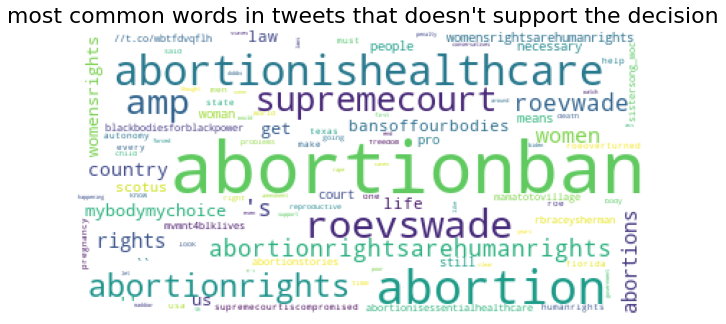

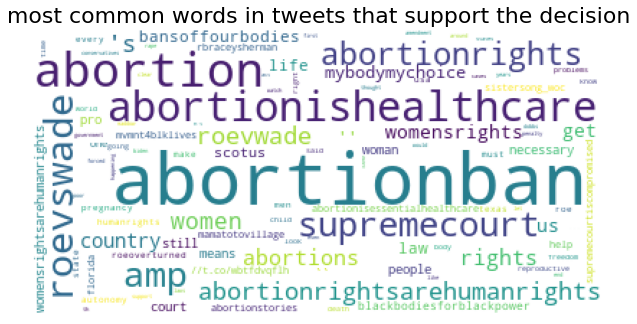

In [ ]:
def word_cloud(freq, title):
  wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate_from_frequencies(freq)
  plt.figure(figsize = (8, 8), facecolor = None)
  plt.imshow(wordcloud)
  plt.axis("off")
  plt.tight_layout(pad = 0)
  plt.title(title, fontsize=22)
  plt.show()
word_cloud(c_opp, "most common words in tweets that doesn't support the decision")
word_cloud(c_pro, "most common words in tweets that support the decision")

Now, let's train the model. first, add features to both kaggle's and our tweets. SpyCy feature and Glove-Twitter feature

In [ ]:
# spacy feature
nlp = spacy.load('en_core_web_lg')
vectors_kgl = []
vectors_our = []

for t in kaggle_sf['text']:
    vectors_kgl.append(nlp(t).vector)
for t in tw_sf['text']:
    vectors_our.append(nlp(t).vector)

kaggle_sf['vector'] = vectors_kgl
tw_sf['vector'] = vectors_our

In [ ]:
#loading Twitter pretrained model
model = api.load("glove-twitter-100")  # download the model and return as object ready for use

[==================================================] 100.0% 387.1/387.1MB downloaded


In [ ]:
# glove model features
def txt2vector(txt):
    words = word_tokenize(txt)
    words = [w for w in words if w in model]
    if len(words) != 0:
        return np.mean([model[w] for w in words], axis=0)
    return None

vectors_kgl = []
vectors_our = []

for txt in kaggle_sf['text']:
    vectors_kgl.append(txt2vector(txt))
for txt in tw_sf['text']:
    vectors_our.append(txt2vector(txt))

kaggle_sf['twitter_vector'] = vectors_kgl
tw_sf['twitter_vector'] = vectors_our

In [ ]:
cls = tc.random_forest_classifier.create(kaggle_sf, features=['vector', 'twitter_vector', 'hashtags'],target='Type', max_iterations=25)

PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.



Random forest classifier:

--------------------------------------------------------

Number of examples          : 125

Number of classes           : 2

Number of feature columns   : 3

Number of unpacked features : 541

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.024590     | 0.984000          | 0.571429            | 0.204207          | 0.757745            |

| 2         | 0.040100     | 0.944000          | 0.571429            | 0.224305          | 0.685100            |

| 3         | 0.048056     | 0.944000          | 0.571429            | 0.227851          | 0.727970            |

| 4         | 0.061414     | 0.968000          | 0.571429            | 0.220815          | 0.653827            |

| 5         | 0.067374     | 0.952000          | 0.571429            | 0.221687          | 0.666709            |

| 10        | 0.111910     | 0.976000          | 0.571429            | 0.214562          | 0.583667            |

| 25        | 0.241374     | 0.984000          | 0.571429            | 0.216098          | 0.646605            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

In [ ]:
tw_sf['Type'] = cls.predict(tw_sf)
tw_sf

X1,tweet_id,user_id,date,text
0,1544684319607820288,1499400541083865091,2022-07-06 14:06:55+00:00,@America1Scotty In mystate of Pennsylvania ...
1,1544521273115660290,540993697,2022-07-06 03:19:01+00:00,#Pennsylvania vote for@JoshShapiroPA we know ...
2,1544515007844581376,1180159675712581642,2022-07-06 02:54:08+00:00,RT @Lost_Loyalist:@SonyaMetzger2 ...
3,1544514861358632967,3224469135,2022-07-06 02:53:33+00:00,@SonyaMetzger2@Kimmiemac21 ...
4,1544508308966572034,1650861697,2022-07-06 02:27:31+00:00,RT @TracyConnor: “There’sa bunch of family ...
5,1544462214471553029,1464405391614562306,2022-07-05 23:24:21+00:00,@JoshShapiroPA@ValArkooshPA Would i ...
6,1544439495705391104,1532046949,2022-07-05 21:54:04+00:00,"Pennsylvania Doctorperformed 40,000 ..."
7,1544430977312849925,3224469135,2022-07-05 21:20:13+00:00,🧵Let me remind everyonethat this guy is ...
8,1544345103635922944,1495439528647139334,2022-07-05 15:38:59+00:00,"RT @unifiedprolife: ""Lastweek, the Rev. Terry ..."
9,1544331652209549314,2508990835,2022-07-05 14:45:32+00:00,@TheGrumpyGitPA@GovernorTomWolf Elec ...


In [ ]:
tw_sf.export_csv('./tweet_with_pred.csv')

Now that we already have a classification of tweets for supporters and not supporters of the court decision, we would like to make a sentinment analysis.

In [ ]:
afinn = Afinn()

tw_sf['afinn_score'] = tw_sf['text'].apply(lambda t: afinn.score(t))

In [ ]:
def afinn2sentiment(score):
    return 'positive' if score > 0 else 'negative' if score < 0 else 'neutral'
tw_sf['sentimnent'] = tw_sf['afinn_score'].apply(lambda label: afinn2sentiment(label))
tw_sf['sentimnent'].value_counts()

value,count
positive,100
neutral,53
negative,45


Finally, let's look at the users who created the tweet:

In [ ]:
tweet_with_user = tw_sf.join(user_sf[['user_id', 'user_location', 'user_followers']], how='left', on='user_id')
tweet_with_user.head(2)

X1,tweet_id,user_id,date,text,hashtags,source
0,1544684319607820288,1499400541083865091,2022-07-06 14:06:55+00:00,@America1Scotty In mystate of Pennsylvania ...,None,
0,1544684319607820288,1499400541083865091,2022-07-06 14:06:55+00:00,@America1Scotty In mystate of Pennsylvania ...,None,
vector,twitter_vector,Type,afinn_score,sentimnent,user_location,user_followers
[-3.04411771e-032.04445675e-01 ...,[ 1.91684410e-011.55902565e-01 ...,Support,2.0,positive,,11
[-3.04411771e-032.04445675e-01 ...,[ 1.91684410e-011.55902565e-01 ...,Support,2.0,positive,,48


### Results
Now that all the features are ready, we want to see the results:
* Analyze the most common words in each type of tweet
* Relationship between the sentinment of the tweet and the class to which it belongs
* The number of followers of the users who created the tweets in each group

In [ ]:
txt_opp_abo = "\n".join(tweet_with_user[tweet_with_user['Type'] == "Doesn't Support"]['text'])
txt_pro_abo = "\n".join(tweet_with_user[tweet_with_user['Type'] == "Doesn't Support"]['text'])
l_opp = [w.lower() for w in word_tokenize(txt_opp_abo) if not skip_word(w)]
l_pro = [w.lower() for w in word_tokenize(txt_pro_abo) if not skip_word(w)]
c_opp = Counter(l_opp)
c_pro = Counter(l_pro)

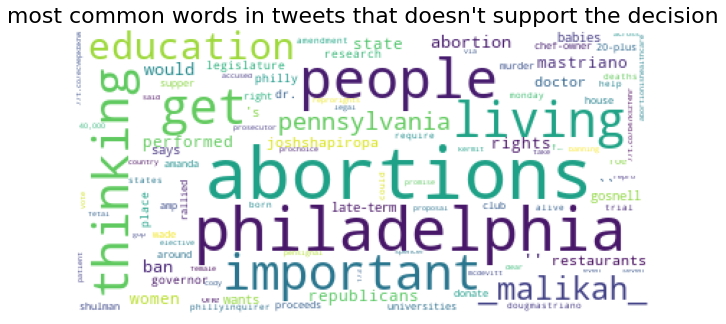

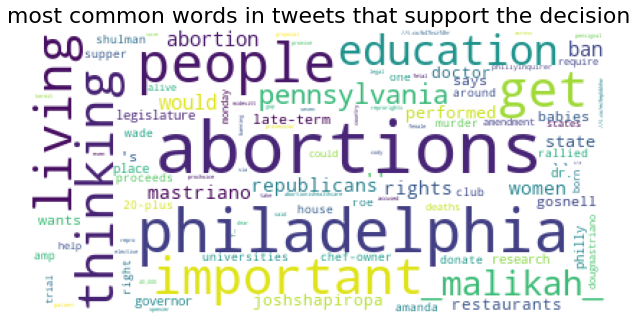

In [ ]:
word_cloud(c_opp, "most common words in tweets that doesn't support the decision")
word_cloud(c_pro, "most common words in tweets that support the decision")

As you can see, it is difficult to see the difference in the content of tweets in each group according to the most common words - each word can be interpreted into two meanings - "living" (from the word "live and let live" and from the meaning of a baby's life), "important", "education" and more

In [ ]:
sentinment_type = tweet_with_user.groupby(['sentimnent', 'Type'], tc.aggregate.COUNT())
tweet_user_df = sentinment_type.to_dataframe()
tweet_user_df

,Type,sentimnent,Count
0,Doesn't Support,neutral,48
1,Support,neutral,164
2,Support,negative,12
3,Doesn't Support,negative,180
4,Doesn't Support,positive,388
5,Support,positive,12


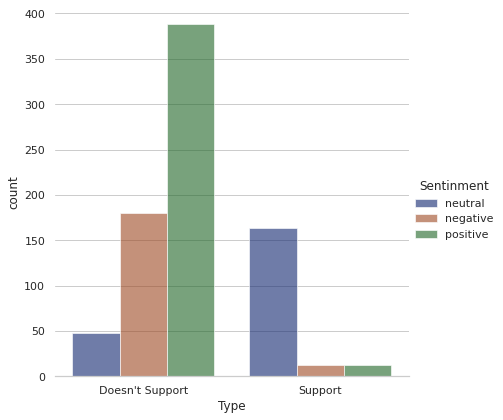

In [ ]:
sns.set_theme(style="whitegrid")

# Draw a nested barplot by species and sex
g = sns.catplot(
    data=tweet_user_df, kind="bar",
    x="Type", y="Count", hue="sentimnent",
    ci="sd", palette="dark", alpha=.6, height=6)
g.despine(left=True)
g.set_axis_labels("Type", "count")
g.legend.set_title("Sentinment")

We received that for tweets that oppose the decision, about a third of the tweets are with negative emotions, compared to tweets that are in favor of the decision, the vast majority of which are neutral.

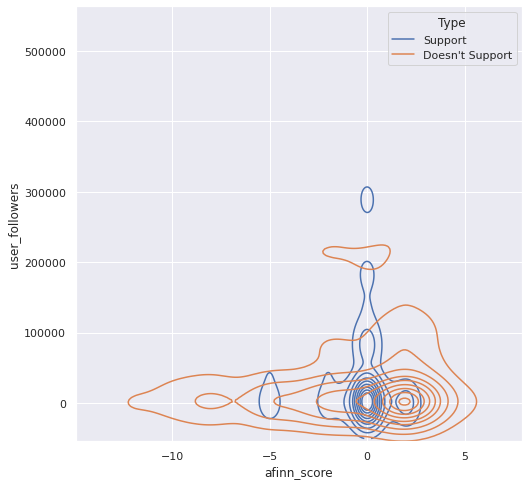

In [ ]:
tweet_with_user_df = tweet_with_user.to_dataframe()
sns.set_theme(style="darkgrid")


# Set up the figure
f, ax = plt.subplots(figsize=(8, 8))
#ax.set_aspect("equal")

# Draw a contour plot to represent each bivariate density
sns.kdeplot(
    data=tweet_with_user_df,
    x="afinn_score",
    y="user_followers",
    hue="Type"
)

There does not seem to be a significant difference in the amount of followers of tweet writers. Again we see that pro-decision posts are more neutral

Finally, we will look at the topics in each group

In [ ]:
# split the df to two: support and desn't support, take pnly the text
tweet_user_df = tweet_user_df[['text', 'Type']]
tweet_pro = tweet_user_df[tweet_user_df['Type'] == 'Support']
tweet_pro.drop_duplicates(subset='text', inplace=True)
tweet_opp = tweet_user_df[tweet_user_df['Type'] == "Doesn't Support"]
tweet_opp.drop_duplicates(subset='text', inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [ ]:
# stemming (lemmatization)
lemmatizer = WordNetLemmatizer()

docs_pro = tweet_pro['text'].apply(lambda txt: [lemmatizer.lemmatize(w) for w in re.findall(r"(\w+)", txt) if not w.startswith('@') and not w.startswith('http') and not len(w)<3 and not w.lower()=='rt'])
docs_opp = tweet_opp['text'].apply(lambda txt: [lemmatizer.lemmatize(w) for w in re.findall(r"(\w+)", txt) if not w.startswith('@') and not w.startswith('http') and not len(w)<3 and not w.lower()=='rt'])
# converting the data to work in Gensim
id2word_pro = corpora.Dictionary(docs_pro)
corpus_pro = [id2word_pro.doc2bow(text) for text in docs_opp]

id2word_opp = corpora.Dictionary(docs_pro)
corpus_opp = [id2word_opp.doc2bow(text) for text in docs_opp]

In [ ]:
lda_model_pro = gensim.models.ldamodel.LdaModel(corpus=corpus_pro,
                                           id2word=id2word_pro,
                                           num_topics=7,
                                           update_every=0,
                                           chunksize=500,
                                           alpha='auto',
                                           per_word_topics=True)
lda_model_opp = gensim.models.ldamodel.LdaModel(corpus=corpus_opp,
                                           id2word=id2word_opp,
                                           num_topics=7,
                                           update_every=0,
                                           chunksize=500,
                                           alpha='auto',
                                           per_word_topics=True)

In [ ]:
pyLDAvis.enable_notebook()
vis_pro = gensimvis.prepare(lda_model_pro, corpus_pro, id2word_pro)
vis_pro

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.098388  0.049290       1        1  25.485467
6      0.104722 -0.008409       2        1  21.884277
0     -0.003398  0.024040       3        1  20.853716
3      0.035955  0.073568       4        1  15.553766
1      0.014109 -0.012991       5        1   7.005805
5     -0.025809 -0.045055       6        1   4.967102
2     -0.027190 -0.080442       7        1   4.249868, topic_info=             Term       Freq      Total Category  logprob  loglift
3    Pennsylvania  25.000000  25.000000  Default  30.0000  30.0000
23            the  41.000000  41.000000  Default  29.0000  29.0000
4        abortion  54.000000  54.000000  Default  28.0000  28.0000
26          would  12.000000  12.000000  Default  27.0000  27.0000
135          with   8.000000   8.000000  Default  26.0000  26.0000
..            ...        ...        ...      ...      ...      ...
76           baby   0.067691   4.221549   Topic7  -5.6258  -0.9747
88         killed   0.067687   2.722287   Topic7  -5.6259  -0.5361
69            law   0.067677   3.078139   Topic7  -5.6260  -0.6591
36           even   0.067675   3.383946   Topic7  -5.6261  -0.7538
119           who   0.067671   4.400162   Topic7  -5.6261  -1.0165

[330 rows x 6 columns], token_table=      Topic      Freq          Term
term                               
1         2  0.811316         Biden
122       3  0.674322        Jersey
123       3  0.674330           New
3         1  0.079575  Pennsylvania
3         2  0.318299  Pennsylvania
...     ...       ...           ...
57        3  0.450366           you
57        4  0.225183           you
57        7  0.225183           you
99        3  0.677909          your
99        4  0.338954          your

[168 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[5, 7, 1, 4, 2, 6, 3])

In [ ]:
vis_opp = gensimvis.prepare(lda_model_opp, corpus_opp, id2word_opp)
vis_opp

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
6      0.097690  0.021197       1        1  38.949763
0      0.085584 -0.053026       2        1  21.491025
3     -0.005919 -0.020140       3        1  10.000771
4     -0.038688  0.076147       4        1   9.752330
1     -0.009055  0.059868       5        1   8.858641
2     -0.056755 -0.017818       6        1   6.929361
5     -0.072857 -0.066227       7        1   4.018110, topic_info=       Term       Freq      Total Category  logprob  loglift
23      the  42.000000  42.000000  Default  30.0000  30.0000
55     want   6.000000   6.000000  Default  29.0000  29.0000
52     they   9.000000   9.000000  Default  28.0000  28.0000
101     are   6.000000   6.000000  Default  27.0000  27.0000
21    state  12.000000  12.000000  Default  26.0000  26.0000
..      ...        ...        ...      ...      ...      ...
88   killed   0.071207   2.425715   Topic7  -5.5191  -0.3139
119     who   0.071197   4.643942   Topic7  -5.5193  -0.9635
140   legal   0.071191   4.106538   Topic7  -5.5193  -0.8406
76     baby   0.071172   4.106526   Topic7  -5.5196  -0.8409
36     even   0.071149   4.053910   Topic7  -5.5199  -0.8283

[348 rows x 6 columns], token_table=      Topic      Freq          Term
term                               
1         2  0.861827         Biden
122       3  0.697954        Jersey
123       3  0.697960           New
3         1  0.487383  Pennsylvania
3         2  0.149964  Pennsylvania
...     ...       ...           ...
26        4  0.094904         would
26        5  0.094904         would
57        1  0.463446           you
57        5  0.231723           you
99        1  0.911139          your

[157 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 1, 4, 5, 2, 3, 6])

It's a bit difficult to understand from the distrabution of topics what the topic of each group is. But it can be seen that the themes are spread over the whole space. That is, the issues are diverse, and less uniform

# Question 2


In [ ]:
! pip install facebook-scraper
! pip install gnews
! pip install newspaper3k
! pip install hebrew_tokenizer
! pip install hebspacy
! pip install pyplutchik==0.0.7
! pip install transformers==4.14.1
! pip install https://github.com/8400TheHealthNetwork/HebSpacy/releases/download/he_ner_news_trf-3.2.1/he_ner_news_trf-3.2.1-py3-none-any.whl

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 44 kB 1.9 MB/s 
     |████████████████████████████████| 288 kB 7.3 MB/s 
     |████████████████████████████████| 132 kB 32.4 MB/s 
     |████████████████████████████████| 749 kB 58.3 MB/s 
     |████████████████████████████████| 83 kB 2.2 MB/s 
     |████████████████████████████████| 139 kB 55.1 MB/s 
     |████████████████████████████████| 112 kB 42.6 MB/s 
     |████████████████████████████████| 127 kB 59.8 MB/s 
  Created wheel for demjson3: filename=demjson3-3.0.5-py3-none-any.whl size=76070 sha256=172ecf805a15b6b3a5d0909bf2d8ba721c505dd54c9b5c7142ed531685f2be74
  Stored in directory: /root/.cache/pip/wheels/c1/8b/a2/29e1cb2a9a3a27a5cfe8a57856a3310ea1e3c0a394eee8db61
  Created wheel for fake-useragent: filename=fake_useragent-0.1.11-py3-none-any.whl size=13502 sha256=67234a1942b5e2eeeb8cb40cf0ee9c4257c1e27ca96b0bce1dd58e20af5d0044
  Stored in di

In [ ]:
from facebook_scraper import get_posts
from gnews import GNews
import nltk
nltk.download('punkt')
import pandas as pd
from newspaper import Article
from newspaper import Config
import dateutil
import hebrew_tokenizer as ht
import spacy
from facebook_scraper import get_posts
from datetime import datetime
from ast import literal_eval
from collections import Counter
import seaborn as sns
from transformers import AutoTokenizer, AutoModel, pipeline

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
07/09/2022 06:11:09 PM - NumExpr defaulting to 2 threads.


## 2.1 - Party: Tikva-Hadasha

1. Data Mining - For the purpose of the analysis, data will be scraped from the Facebook page of the New Hope Party. In addition, we would like to see news articles in which New Hope has mentioned. I was also wanted to analyze data on laws submitted by party members, but the [Knesset website](https://main.knesset.gov.il/Activity/Legislation/Laws/Pages/LawSuggestionsSearch.aspx?t=lawsuggestionssearch&st=currentknesset) does not allow rendering in convenient way the html page (using dynamic HTML, displaying 30 results on each page out of 4000- requires a lot of work, it is not possible to download the database ..) so I will try to identify bills from the information we scraped - posts and news.
2. Features extraction - the text in the data we scraped is written in Hebrew, which makes it difficult to analyze the data. Still, I wanted to experiment with using existing packages in Hebrew (it's really nice and exciting!) So it's a bit detrimental to the capabilities of the analysis. Despite everything, I used NER to identify entities, tokenaizer, and also identify legislation using keywords. I used three main packages: [HebSpyCy](https://github.com/8400TheHealthNetwork/HebSpacy#he_ner_news_trf),
[Hebrew-Tokenizer](https://github.com/YontiLevin/Hebrew-Tokenizer) and [HeBERT](https://github.com/avichaychriqui/HeBERT?fbclid=IwAR0GVuSWEvYWimkV4Z22h6-GSEznY2G2eIRz7gDGcAcHT3hB4vgUkxkBCPg). **The goal**: to introduce people mentioned in the text (and thus see who is active in the party), party legislation, sentiment analysis of Facebook posts, and activity on Facebook and news throughout the period.

### Data Mining

From Facebook

In [ ]:
posts = get_posts('ilNewHope', pages=20, cookies='./facebook.com_cookies.txt')

In [ ]:
posts_newHope = pd.DataFrame()
# populate the dataframe
for post in posts:
    posts_newHope = posts_newHope.append(pd.DataFrame({'post_id': [post['post_id']],
                                               'text': [post['post_text']],
                                             'comments': [post['comments']],
                                             'likes': [post['likes']],
                                             'shares': [post['shares']],
                                             'time': [post['time']]}))

    posts_newHope = posts_newHope.reset_index(drop=True)
# show the dataframe
posts_newHope.head()

/usr/local/lib/python3.7/dist-packages/facebook_scraper/facebook_scraper.py:881: UserWarning: Facebook says 'Unsupported Browser'
  warnings.warn(f"Facebook says 'Unsupported Browser'")


,post_id,text,comments,likes,shares,time
0,340903914881249,מדינת ישראל מכירה באחים השכולים- עשינו היסטורי...,22,130,25,2022-07-01 08:34:07
1,340510844920556,מה הספקנו ב-48 השעות האחרונות?\nתשעה חוקים שאו...,13,60,13,2022-06-30 16:23:57
2,338199401818367,לימודי ליבה גם בחברה החרדית!\n\nלאחר מאמץ של ח...,2,24,1,2022-06-27 19:37:21
3,333486322289675,לאחר מאבק של למעלה מעשור יו״ר סיעת תקווה חדשה ...,7,20,0,2022-06-20 14:26:00
4,332870455684595,עשינו היסטוריה!\n\nאני מתרגשת לבשר שהיום אושרה...,4,19,0,2022-06-19 15:03:09


In [ ]:
posts_newHope = posts_newHope[posts_newHope['time']>'2021-06-13']

From news

In [ ]:
# search on google-news - only english, since 13/6/21
news = GoogleNews(start='13/06/2021', lang='he', region='IL', encode='utf-8')

In [ ]:
# query:
news.search("תקווה חדשה")  # and then Pennsylvania

# search:
result = news.result()
news_df = pd.DataFrame.from_dict(result)
news_df = news_df.drop(columns=["img"])

# search also in the next 40 pages:
for page in range(2,40):
  result = news.page_at(page)
  tmp_df = pd.DataFrame.from_dict(result)
  news_df = pd.concat([news_df, tmp_df], ignore_index=True)

news_df.head(2)

In [ ]:
# get content and parser

def get_text_operations(url):
  # configurations:
  user_agent = 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; rv:78.0) Gecko/20100101 Firefox/78.0'
  config = Config()
  config.browser_user_agent = user_agent
  config.request_timeout = 80

  # download:
  article = Article(url, config=config)
  try:
    article.download()
    article.parse()
  except:
    return None
  # parser & nlp
  txt = article.text


  return txt
full_txt = []
for i in news_df['link']:
  full_txt.append(get_text_operations(i))
news_df['full_txt'] = full_txt


In [ ]:
news_df.to_csv('./news_tikva.csv')

### Analysis

In [ ]:
# split the datetime
posts_newHope['day_of_month'] = posts_newHope['time'].apply(lambda dt: dateutil.parser.parse(dt).day)
posts_newHope['month'] = posts_newHope['time'].apply(lambda dt: dateutil.parser.parse(dt).month)
posts_newHope['year'] = posts_newHope['time'].apply(lambda dt: dateutil.parser.parse(dt).year)
posts_newHope['hour'] = posts_newHope['time'].apply(lambda dt: dateutil.parser.parse(dt).hour)
posts_newHope['year-month'] = posts_newHope.apply(lambda x: str(x['year']) + "-" + str(x['month']), axis=1)

**Tokenazie**

In [ ]:
# word and sentences tokinaze

# for news:
words = []
sen = []
for i in news_df['full_txt']:
  words.append([token for grp, token, token_num, (start_index, end_index) in ht.tokenize(str(i)) if len(str(token)) > 1 and grp != 'PUNCTUATION'])
  sen.append(str(i).split('.'))
news_df['words'] = words
news_df['sentences'] = sen

# for posts
words = []
sen = []
for i in posts_newHope['text']:
  words.append([token for grp, token, token_num, (start_index, end_index) in ht.tokenize(str(i)) if len(str(token)) > 1 and grp != 'PUNCTUATION'])
  sen.append(str(i).split('.'))
posts_newHope['words'] = words
posts_newHope['sentences'] = sen

**Entities**

In [ ]:
# name entity
nlp = spacy.load("he_ner_news_trf")

def name_entity(text):
    entity_lst = []
    doc = nlp(text)
    for entity in doc.ents:
        entity_lst.append((entity.text, entity.label_))
    return entity_lst

# for news
l = []
for i in news_df['full_txt']:
    l.append(name_entity(str(i)))
news_df['entities'] = l

# for posts
l = []
for i in posts_newHope['text']:
    l.append(name_entity(str(i)))
posts_newHope['entities'] = l

In [ ]:
# copy the whole dict and stack it
posts_newHope['entities_all'] = posts_newHope['entities']
posts_newHope_stack_entity = posts_newHope.explode('entities').reset_index(drop=True)

news_df['entities_all'] = news_df['entities']
news_df_stack_entity = news_df.explode('entities').reset_index(drop=True)

In [ ]:
# split the type and name, select only PERS
posts_newHope_stack_entity.dropna(subset=['entities'], inplace=True)
news_df_stack_entity.dropna(subset=['entities'], inplace=True)
def split_tuple(x):
  x = x['entities']
  return x[1], x[0]

posts_newHope_stack_entity[['entity_type', 'entity_name']] = posts_newHope_stack_entity[['entities']].apply(split_tuple, axis=1, result_type='expand')
posts_newHope_stack_entity = posts_newHope_stack_entity[posts_newHope_stack_entity['entity_type'].isin(['PERS'])]

news_df_stack_entity[['entity_type', 'entity_name']] = news_df_stack_entity[['entities']].apply(split_tuple, axis=1, result_type='expand')
news_df_stack_entity = news_df_stack_entity[news_df_stack_entity['entity_type'].isin(['PERS'])]

**Events**

In [ ]:
# words describe an event
opposition = ['האופוזיציה', 'אופוזיציה']
election = ['הבחירות' ,'בבחירות', 'בחירות']
vaadot = ['ועדה', 'ועדת', 'וועדה', 'וועדת', 'דיון']
law = ['חוק', 'החוק', 'חוקים', 'חוקי', 'חוקקנו', 'חוקקתי', 'חקיקה', 'החקיקה', 'תקנות', 'התקנות']
event_dic = {'election': election, 'vaadot': vaadot, 'law': law, 'opposition': opposition}

In [ ]:
# find words in sentences that belong to specific event
def find_events(txt, events):
  event_in_txt = {}
  for sen in txt:
    for event_type in events:
      for word in events[event_type]:
        if word in sen:
          if event_type in event_in_txt:
            event_in_txt[event_type].append(sen)
          else:
            event_in_txt[event_type] = [sen]
  return event_in_txt


In [ ]:
# add events in post to post
events = []
for i in posts_newHope['sentences']:
  events.append(find_events(i, event_dic))
posts_newHope['events_dic'] = events
posts_newHope.dropna(subset=['events_dic'], inplace=True)

events = []
for i in news_df['sentences']:
  events.append(find_events(i, event_dic))
news_df['events_dic'] = events
news_df.dropna(subset=['events_dic'], inplace=True)

In [ ]:
# explode and add event's sentences to each post
def get_sent_event(event_dic, key):
  if key in event_dic:
    return event_dic[key]
  else:
    return None
posts_newHope['event_dic_all'] = posts_newHope['events_dic']
posts_newHope_stack = posts_newHope.explode('events_dic').reset_index(drop=True)
posts_newHope_stack['event_sens'] = posts_newHope_stack.apply(lambda x: get_sent_event(x['event_dic_all'], x['events_dic']), axis=1)

news_df['event_dic_all'] = news_df['events_dic']
news_df_stack = news_df.explode('events_dic').reset_index(drop=True)
news_df_stack['event_sens'] = posts_newHope_stack.apply(lambda x: get_sent_event(x['event_dic_all'], x['events_dic']), axis=1)

**Sentiment analysis**

In [ ]:
tokenizer = AutoTokenizer.from_pretrained("avichr/heBERT_sentiment_analysis") #same as 'avichr/heBERT' tokenizer
model = AutoModel.from_pretrained("avichr/heBERT_sentiment_analysis")
sentiment_analysis = pipeline(
    "sentiment-analysis",
    model="avichr/heBERT_sentiment_analysis",
    tokenizer="avichr/heBERT_sentiment_analysis",
    return_all_scores = False
)

l = []
for i in posts_newHope['text']:
    try:
        sent = sentiment_analysis(str(i))
    except RuntimeError as e:
        i = i[:500]
        sent = sentiment_analysis(str(i))
        pass
    if sent[0]['score'] > 0.8:
        l.append(sent[0]['label'])
    else:
        l.append([])
posts_newHope['sentiment'] = l

### Results

**statistics**

[Text(0.5, 1.0, "New's number of Tikva-Hadash")]

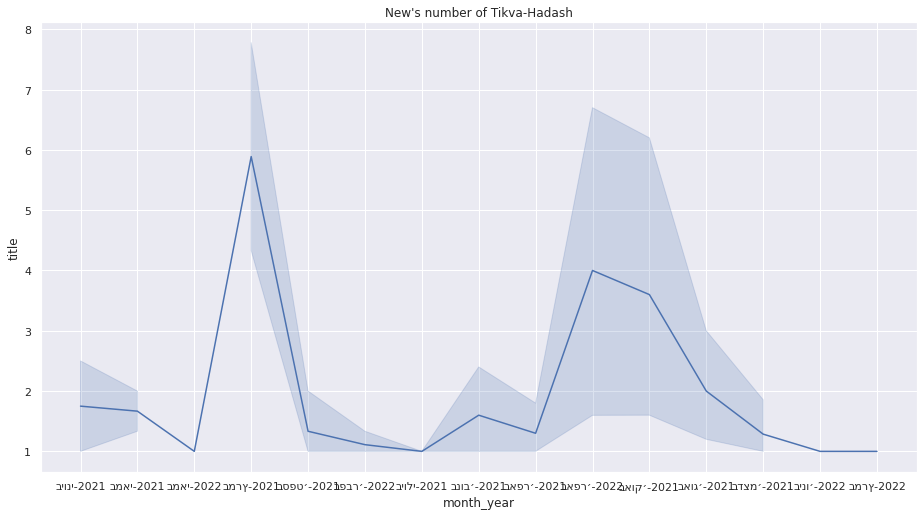

In [ ]:
news_count = news_df.groupby('date')['title'].count()
news_count = pd.DataFrame(news_count)
news_count.reset_index(inplace=True)
news_count['date'] = news_count['date'].apply(lambda x: x.split(" "))
news_count = news_count[news_count['date'].map(len) == 3]
news_count.drop( axis=0, index=[83, 84,85, 86, 87, 88, 90], inplace=True)
news_count['month_year'] = news_count.apply(lambda x: str(x['date'][1]) + "-" + str(x['date'][2]), axis=1)
sns.set(rc={'figure.figsize':(15.7,8.27)})
sns.lineplot(data=news_count, x="month_year", y="title").set(title="New's number of Tikva-Hadash")

[Text(0.5, 1.0, "Number of NewHope's posts over the year")]

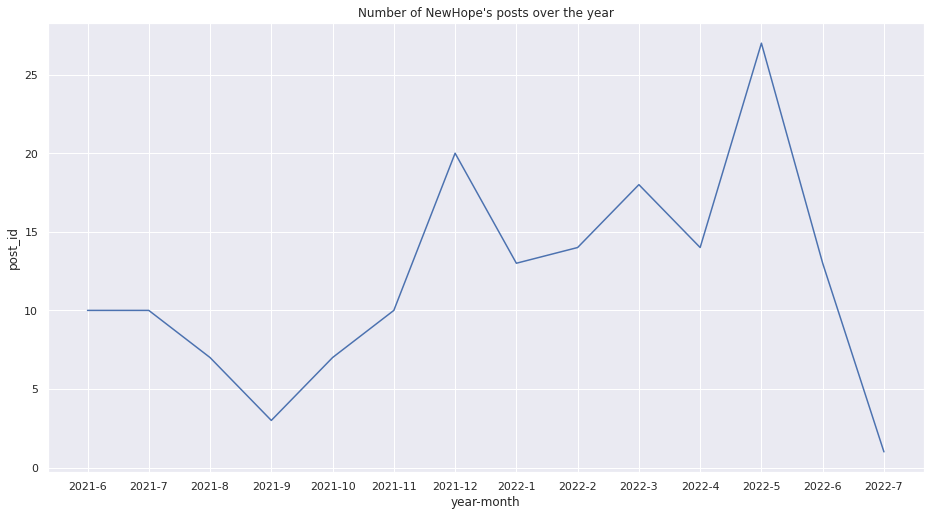

In [ ]:
tikva_posts_month = posts_newHope.groupby(['year', 'month', 'year-month'])['post_id'].count()
tikva_posts_month = pd.DataFrame(tikva_posts_month)
tikva_posts_month.reset_index(inplace=True)
sns.set(rc={'figure.figsize':(15.7,8.27)})
sns.lineplot(data=tikva_posts_month, x="year-month", y="post_id").set(title="Number of NewHope's posts over the year")

Recently, many posts have been posted on the party's page, apparently ahead of the dissolution of the Knesset and the run-up to the elections. In the second half of the year of activity in the Knesset, more posts can be seen

**sentiment analysis**

[Text(0.5, 1.0, "Number of NewHope's posts classied by sentiments")]

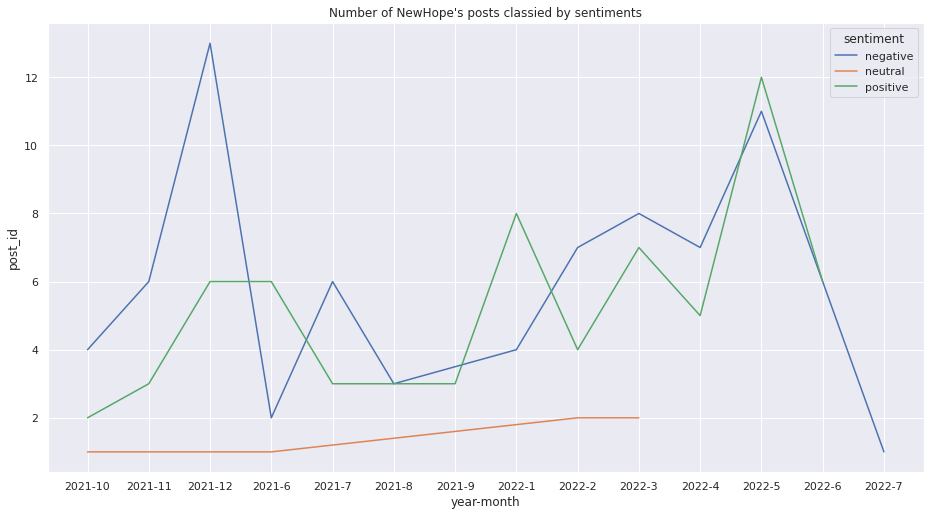

In [ ]:
posts_sent = posts_newHope.groupby(['year-month', 'sentiment'])['post_id'].count()
posts_sent = pd.DataFrame(posts_sent)
posts_sent.reset_index(inplace=True)
sns.set(rc={'figure.figsize':(15.7,8.27)})
sns.lineplot(data=posts_sent[posts_sent['sentiment'] != '[]'], x="year-month", y="post_id", hue="sentiment").set(title="Number of NewHope's posts classied by sentiments")

It is interesting to see that in the run-up to the dissolution of the Knesset, there are more posts with negative sintement.

**Laws and more:**

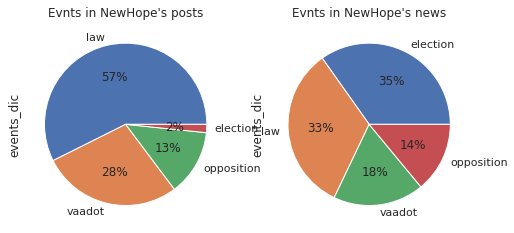

In [ ]:
fig, axs = plt.subplots(ncols=2)

news_df_stack['events_dic'].value_counts().plot(kind='pie', autopct='%1.0f%%', title="Evnts in NewHope's news", figsize=(8,8), ax=axs[1])
posts_newHope_stack['events_dic'].value_counts().plot(kind='pie', autopct='%1.0f%%', title="Evnts in NewHope's posts", figsize=(8,8), ax=axs[0])

Here, too, the elections seem to have taken a respectable place in the news, as has the description of the legislation, which is especially emphasized in the posts - in order to describe to the public the party's activities and thus persuade them to vote for them. A smaller amount of posts is concentrated in Vaadot and the opposition

**Entities:**

In [ ]:
# get separete dict for each event type
per = {}

bibi = ['ביבי', 'בנימין נתניהו', 'ביבי נתניהו', 'נתניהו', 'יו"ר האופוזיציה']
for i,r in posts_newHope_stack_entity.iterrows():
  type_e = r['entity_type']
  name_e = r['entity_name']

  if ((type_e == 'PERS') & (name_e != [])):
    if name_e in bibi:
      name_e = 'בנימין נתניהו'
    if name_e in per:
      per[name_e] +=1
    else:
      per[name_e] = 1
for i,r in news_df_stack_entity.iterrows():
  type_e = r['entity_type']
  name_e = r['entity_name']

  if ((type_e == 'PERS') & (name_e != [])):
    if name_e in bibi:
      name_e = 'בנימין נתניהו'
    if name_e in per:
      per[name_e] +=1
    else:
      per[name_e] = 1

In [ ]:
per

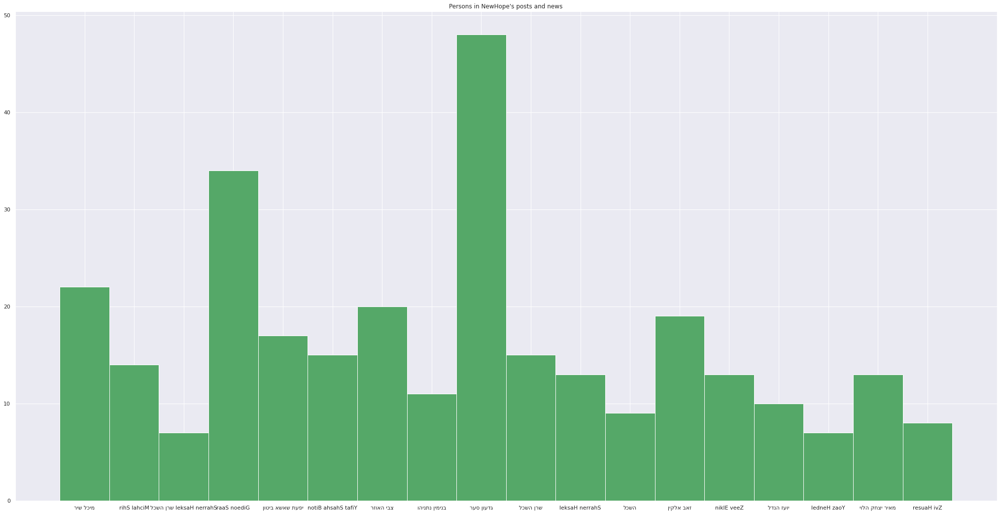

In [ ]:
# plot person (appears more then twice)
per = {k:v for k,v in  per.items() if v>5}
plt.title("Persons in NewHope's posts and news")

plt.bar(per.keys(), per.values(), 1.0, color='g')
x_axis= [x[::-1] for x in per.keys()]
locs, labels = plt.xticks()
sns.set(rc={'figure.figsize':(35.7,18.27)})
plt.xticks(ticks=locs, labels=x_axis)
plt.show()

As expected, most of the posts are about the head of the party - Gideon Saar. But there is also a considerable amount for Sharan Hashakel, Zvi Hauser and Michal Shir. Really their making has made headlines

## 2.2 - Politician - Ze'ev Elkin


I took the data about the activity of Minister Elkin in the social networks from Facebook.
1. Scratching the data - I will take all the posts that have been published since the formation of the government. We will take all the information given - content, likes, shares and more.
2. Extract the featuures from the text. Here, too, the texts are of written in Hebrew. I will therefore use appropriate packages such as [HebSpyCy](https://github.com/8400TheHealthNetwork/HebSpacy#he_ner_news_trf)  and
[Hebrew-Tokenizer](https://github.com/YontiLevin/Hebrew-Tokenizer) to spread the text and identify entities. Because there are not many packages that support Hebrew, I had to identify events in the text using keywords I defined for each event, as can be seen below.
3. Present interesting information about Elkin's posts - quantities, events described in the posts, entities and statistical information about the posts.

### Data Mining

In [ ]:
# collect posts from Facebook
posts = get_posts('Elkin.Zeev', pages=50, cookies='./facebook.com_cookies.txt')

elkin_post = pd.DataFrame()
# populate the dataframe
gov_date = datetime.strptime('2021-06-13 00:00:00', '%Y-%m-%d %H:%M:%S')
for post in posts:
  if [post['time']][0] < gov_date:  # get the posts from last year only
    break
  elkin_post = elkin_post.append(pd.DataFrame({'post_id': [post['post_id']],
                                               'text': [post['post_text']],
                                             'comments': [post['comments']],
                                             'likes': [post['likes']],
                                             'shares': [post['shares']],
                                             'time': [post['time']]}))

  elkin_post = elkin_post.reset_index(drop=True)
# show the dataframe
elkin_post.head()

/usr/local/lib/python3.7/dist-packages/facebook_scraper/facebook_scraper.py:881: UserWarning: Facebook says 'Unsupported Browser'
  warnings.warn(f"Facebook says 'Unsupported Browser'")


limit!!!!


,post_id,text,comments,likes,shares,time
0,589259252561092,אתמול השתתפתי בטקס סיום תואר באוניברסיטת אריאל...,35,247,6,2022-07-05 07:37:53
1,588714445948906,"יצאנו לדרך, ואנחנו צריכים אתכם איתנו.\nכדי שנמ...",152,460,10,2022-07-04 09:36:38
2,588302005990150,החלה ההרשמה להגרלה נוספת של ׳דירה בהנחה׳!\n\nב...,77,257,20,2022-07-03 16:18:05
3,586179212869096,"עשינו את זה!\nאחרי מאבק נחוש, לא פשוט, ועם לחצ...",149,488,17,2022-06-30 09:25:45
4,585828236237527,"""כל המציל נפש אחת, כאילו הציל עולם ומלואו.""\n\...",25,172,6,2022-06-29 19:30:34


In [ ]:
elkin_post.to_csv('./elkin_post.csv')

### Analysis

**Tokenize:**

In [ ]:
# word and sentences tokinaze
words = []
sen = []
for i in elkin_posts['text']:
  words.append([token for grp, token, token_num, (start_index, end_index) in ht.tokenize(str(i)) if len(str(token)) > 1 and grp != 'PUNCTUATION'])
  sen.append(str(i).split('.'))
elkin_posts['words'] = words
elkin_posts['sentences'] = sen
elkin_posts.head(3)

,Unnamed: 0,post_id,text,comments,likes,shares,time,words,sentences
0,0,589259252561092,אתמול השתתפתי בטקס סיום תואר באוניברסיטת אריאל...,35,247,6,2022-07-05 07:37:53,"[אתמול, השתתפתי, בטקס, סיום, תואר, באוניברסיטת...",[אתמול השתתפתי בטקס סיום תואר באוניברסיטת אריא...
1,1,588714445948906,"יצאנו לדרך, ואנחנו צריכים אתכם איתנו.\nכדי שנמ...",152,460,10,2022-07-04 09:36:38,"[יצאנו, לדרך, ואנחנו, צריכים, אתכם, איתנו, כדי...","[יצאנו לדרך, ואנחנו צריכים אתכם איתנו, \nכדי ש..."
2,2,588302005990150,החלה ההרשמה להגרלה נוספת של ׳דירה בהנחה׳!\n\nב...,77,257,20,2022-07-03 16:18:05,"[החלה, ההרשמה, להגרלה, נוספת, של, דירה, בהנחה,...",[החלה ההרשמה להגרלה נוספת של ׳דירה בהנחה׳!\n\n...


**Name entity:**

In [ ]:
# name entity

nlp = spacy.load("he_ner_news_trf")

def name_entity(text):
    entity_lst = []
    doc = nlp(text)
    for entity in doc.ents:
        entity_lst.append((entity.text, entity.label_))
    return entity_lst

l = []
for i in elkin_posts['text']:
    l.append(name_entity(str(i)))
elkin_posts['entities'] = l

In [ ]:
# copy the whole dict and stack it
elkin_posts['entities_all'] = elkin_posts['entities']
elkin_posts_stack_entity = elkin_posts.explode('entities').reset_index(drop=True)

In [ ]:
# split the type and name, select only LOC, EVE and PERS
elkin_posts_stack_entity.dropna(subset=['entities'], inplace=True)
def split_tuple(x):
  x = x['entities']
  return x[1], x[0]
elkin_posts_stack_entity[['entity_type', 'entity_name']] = elkin_posts_stack_entity[['entities']].apply(split_tuple, axis=1, result_type='expand')
elkin_posts_stack_entity = elkin_posts_stack_entity[elkin_posts_stack_entity['entity_type'].isin(['PERS', 'EVE', 'LOC'])]

**Events:**

In [ ]:
# words describe an events
sign = ['חתמתי', 'חתמנו', 'חתימה']
meets = ['פגשתי', 'פגישה', 'נפגשתי', 'הפגישה', 'נפגשנו', 'בפגישה']
interview = ['ראיון', 'התראיינתי', 'הראיון','בראיון', 'טלווזיה', 'רדיו']
visit = ['נסעתי', 'ביקרתי', 'נסענו', 'ביקרנו', 'הגעתי', 'הגענו' ,'השתתפתי', 'השתתפנו']
law = ['חוק', 'החוק', 'חוקים', 'חוקי', 'חוקקנו', 'חוקקתי', 'חקיקה', 'החקיקה']
event_dic = {'sign': sign, 'meetings': meets, 'interviews': interview, 'visits': visit, 'laws': law}

In [ ]:
# find words in sentences that belong to specific event
def find_events(txt, events):
  event_in_txt = {}
  for sen in txt:
    for event_type in events:
      for word in events[event_type]:
        if word in sen:
          if event_type in event_in_txt:
            event_in_txt[event_type].append(sen)
          else:
            event_in_txt[event_type] = [sen]
  return event_in_txt


In [ ]:
# add events in post to post
events = []
for i in elkin_posts['sentences']:
  events.append(find_events(i, event_dic))
elkin_posts['events_dic'] = events
elkin_posts.dropna(subset=['events_dic'], inplace=True)

In [ ]:
# explode and add event's sentences to each post
def get_sent_event(event_dic, key):
  if key in event_dic:
    return event_dic[key]
  else:
    return None
elkin_posts['event_dic_all'] = elkin_posts['events_dic']
elkin_posts_stack = elkin_posts.explode('events_dic').reset_index(drop=True)
elkin_posts_stack['event_sens'] = elkin_posts_stack.apply(lambda x: get_sent_event(x['event_dic_all'], x['events_dic']), axis=1)

In [ ]:
elkin_posts_stack.head(1)

,Unnamed: 0,Unnamed: 0.1,post_id,text,comments,likes,shares,time,words,sentences,entities,events_dic,event_dic_all,event_sens
0,0,0,589259252561092,אתמול השתתפתי בטקס סיום תואר באוניברסיטת אריאל...,35,247,6,2022-07-05 07:37:53,"['אתמול', 'השתתפתי', 'בטקס', 'סיום', 'תואר', '...",[אתמול השתתפתי בטקס סיום תואר באוניברסיטת אריא...,"[('באוניברסיטת אריאל', 'ORG'), ('האוניברסיטאית...",visits,{'visits': ['אתמול השתתפתי בטקס סיום תואר באונ...,[אתמול השתתפתי בטקס סיום תואר באוניברסיטת אריא...


In [ ]:
# spilt the datetime column
elkin_posts_stack['day_of_month'] = elkin_posts_stack['time'].apply(lambda dt: dateutil.parser.parse(dt).day)
elkin_posts_stack['month'] = elkin_posts_stack['time'].apply(lambda dt: dateutil.parser.parse(dt).month)
elkin_posts_stack['year'] = elkin_posts_stack['time'].apply(lambda dt: dateutil.parser.parse(dt).year)
elkin_posts_stack['hour'] = elkin_posts_stack['time'].apply(lambda dt: dateutil.parser.parse(dt).hour)
elkin_posts_stack['year-month'] = elkin_posts_stack.apply(lambda x: str(x['year']) + "-" + str(x['month']), axis=1)


In [ ]:
elkin_posts_stack.to_csv('./elkin_post_event_sen_time.csv')

### Results

**Posts statistic:**

Let's take a look on Elkin activity in the Facebook over the last year:

07/09/2022 06:34:31 PM - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
07/09/2022 06:34:31 PM - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0.5, 1.0, "Number of Elkin's posts over the year")]

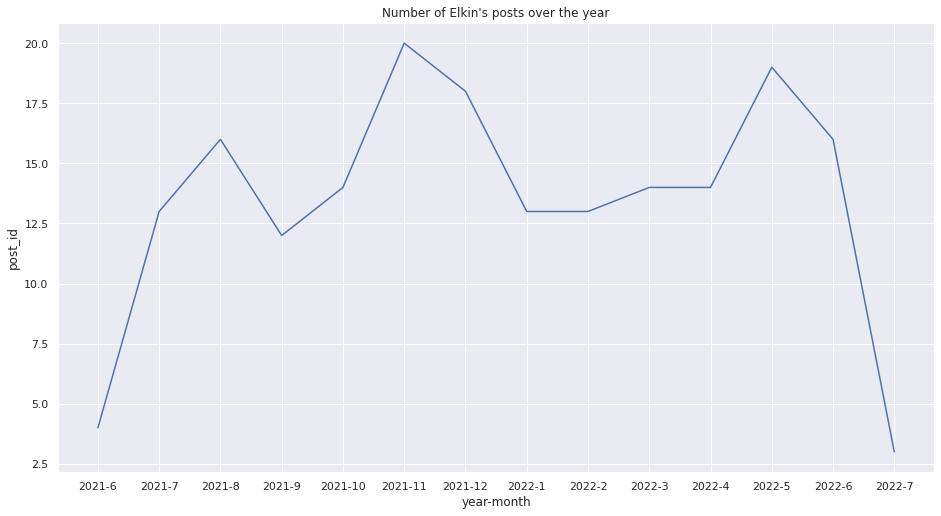

In [ ]:
elkin_posts_month = elkin_posts.groupby(['year', 'month', 'year-month'])['post_id'].count()
elkin_posts_month = pd.DataFrame(elkin_posts_month)
elkin_posts_month.reset_index(inplace=True)
sns.set(rc={'figure.figsize':(15.7,8.27)})
sns.lineplot(data=elkin_posts_month, x="year-month", y="post_id").set(title="Number of Elkin's posts over the year")

In [ ]:
# most common words
words_posts = []
for word_lst in elkin_posts['words']:
  for word in word_lst:
    words_posts.append(word)
c = Counter(words_posts)
c = dict(c.most_common(100))
c

{'000': 38,
 '12': 20,
 'אבל': 15,
 'אזרחי': 24,
 'אחד': 16,
 'אחרי': 24,
 'אישרנו': 15,
 'אלפי': 20,
 'אנו': 18,
 'אנחנו': 28,
 'אני': 50,
 'את': 275,
 'בהנחה': 24,
 'בין': 21,
 'בישראל': 16,
 'בכל': 32,
 'בראיון': 21,
 'בשורה': 15,
 'בשנה': 15,
 'גם': 44,
 'דברים': 13,
 'דיור': 56,
 'דירה': 42,
 'דירות': 28,
 'הארץ': 17,
 'הבוקר': 31,
 'הבינוי': 27,
 'הבנייה': 18,
 'הגולן': 22,
 'הגיבו': 23,
 'הדיור': 48,
 'הדירות': 25,
 'ההתיישבות': 16,
 'הוא': 32,
 'הזה': 22,
 'היא': 15,
 'היה': 18,
 'היום': 74,
 'היצע': 14,
 'הכנסת': 17,
 'הם': 19,
 'המדינה': 24,
 'המכר': 13,
 'הממשלה': 28,
 'העיר': 19,
 'הערב': 15,
 'הצעירים': 21,
 'הרבה': 17,
 'והשיכון': 28,
 'ושתפו': 24,
 'זה': 45,
 'זו': 14,
 'חדשה': 18,
 'חדשות': 19,
 'חוק': 16,
 'טוב': 16,
 'יום': 20,
 'יותר': 23,
 'יחד': 15,
 'יחידות': 48,
 'ירושלים': 43,
 'ישראל': 80,
 'כבר': 14,
 'כדי': 28,
 'כל': 52,
 'לא': 63,
 'להם': 14,
 'לזוגות': 17,
 'לכל': 16,
 'למען': 20,
 'לעבוד': 34,
 'מדינת': 20,
 'מול': 18,
 'מחיר': 14,
 'ממשיכים': 13,
 'משרד'

The number of posts per month for Elkin is between 12-20 (first and last month were partial). It can be seen that the most common words are related to the work of his office - construction and apartments

**Events:**

First of all, let's look at the event's distribution that are written about in the posts:

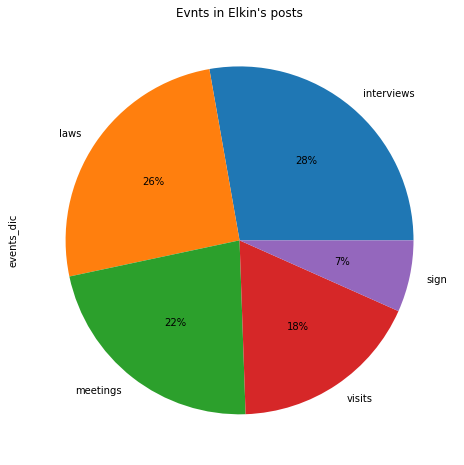

In [ ]:
elkin_posts_stack['events_dic'].value_counts().plot(kind='pie', autopct='%1.0f%%', title="Evnts in Elkin's posts", figsize=(8,8))

As you can see, most of the posts are about describing interviews and TV appearances he gave, then describing rules and meetings.

Now, we will look at the amount of posts each day (X-axis) during the month and year (animation below). Color = event type, size = amount of likes per post

In [ ]:
df = elkin_posts_stack.dropna(subset=['events_dic'])
import plotly.express as px


px.scatter(df, x="day_of_month", y="hour", animation_frame="year-month", animation_group="event_sens",
           size="likes", color="events_dic", hover_name="events_dic", title="Posts at time, with #like, classified by event",
            size_max=25, range_x=[1,31], range_y=[0,24])

Let's look at the popularity of posts by events: function of number of comments, likes and shares, classified by event (colors)

In [ ]:
import plotly.express as px
df = elkin_posts_stack.dropna(subset=['events_dic'])
fig = px.scatter_3d(df, x="likes", y="shares", z="comments", color="events_dic", hover_name="event_sens")
fig.show()

**Entity:**

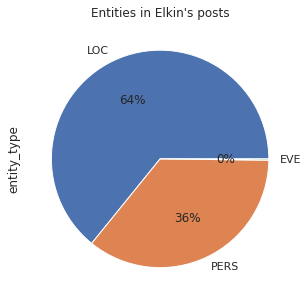

In [ ]:
elkin_posts_stack_entity['entity_type'].value_counts().plot(kind='pie', autopct='%1.0f%%', title="Entities in Elkin's posts", figsize=(5,5))

In [ ]:
# get separete dict for each event type
per = {}
loc = {}
eve = {}
bibi = ['ביבי', 'בנימין נתניהו', 'ביבי נתניהו', 'נתניהו']
for i,r in elkin_posts_stack_entity.iterrows():
  type_e = r['entity_type']
  name_e = r['entity_name']
  if type_e == 'LOC':
    if name_e in loc:
      loc[name_e] +=1
    else:
      loc[name_e] = 1
  elif type_e == 'PERS':
    if name_e in bibi:
      name_e = 'בנימין נתניהו'
    if name_e in per:
      per[name_e] +=1
    else:
      per[name_e] = 1
  else:
    if name_e in eve:
      eve[name_e] +=1
    else:
      eve[name_e] = 1

([<matplotlib.axis.XTick at 0x7f1214840f10>,
 [Text(0, 0, 'והינתנ ןימינב'),
  Text(0, 0, 'יביט'),
  Text(0, 0, 'ןמרביל רודגיבא'),
  Text(0, 0, 'דקש'),
  Text(0, 0, 'רעס ןועדג'),
  Text(0, 0, 'טנב ילתפנ'),
  Text(0, 0, 'ןיקסר בינל')])

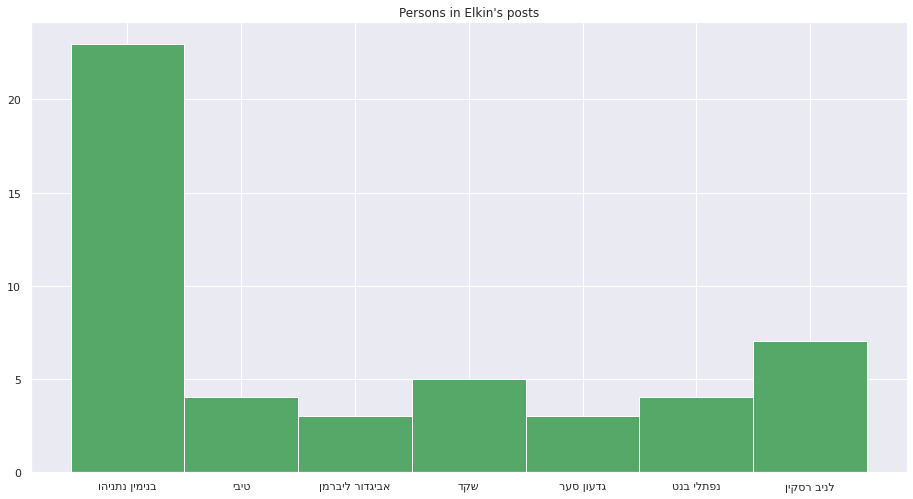

In [ ]:
# plot person (appears more then twice)
per = {k:v for k,v in  per.items() if v>2}
plt.title("Persons in Elkin's posts")

plt.bar(per.keys(), per.values(), 1.0, color='g')
x_axis= [x[::-1] for x in per.keys()]
locs, labels = plt.xticks()
plt.xticks(ticks=locs, labels=x_axis)

Text(0.5, 1.0, "Persons in Elkin's posts")

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127470 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 127473 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127470 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 127473 missing from current font.
  font.set_text(s, 0, flags=flags)


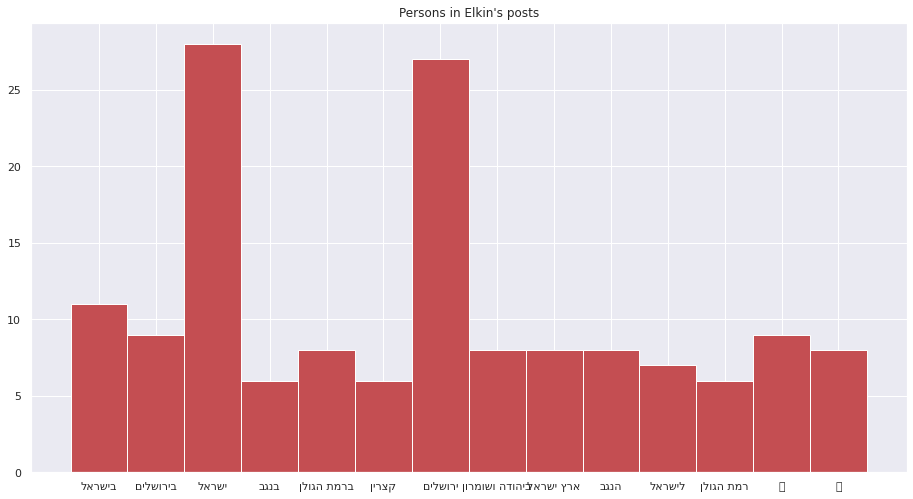

In [ ]:
# plot locations
loc = {k:v for k,v in  loc.items() if v>5}
plt.bar(loc.keys(), loc.values(), 1.0, color='r')

# for Hebrew...
x_axis= [x[::-1] for x in loc.keys()]
locs, labels = plt.xticks()
plt.xticks(ticks=locs, labels=x_axis)

plt.title("Persons in Elkin's posts")


As you can see (and expect) Benjamin Netanyahu is mentioned many times in Elkin's posts. In addition, the places most mentioned are, as expected, Israel, and various places, such as the Ramat HaGolan, Katzrin, the Negev and more, as expected of the Minister of Construction and Housing

# Question 3
In this part, too, we will divide the work into three parts:
1. Collecting the images - We would like to group the photos into a database from various places: the Dalle's Instagram page, a Twitter page that publishes photos created with the software, and a news page that presents content about the new software.

2. We will now analyze the data:
* We will first examine the similarities between the images -
I expect images created from the same algorithm to be similar. We will do this with the tools learned in the course (package of turicreate). And we will present the results visually.
*  I will analyze the content of the images - with the help of identifying objects in the images we will want to know what the image contains. I will use the imageAI package. We will represent the objects that appear by distribution.
Since the pictures can be really illogical (a person made of iron for example), the identification can be difficult. In an ideal world, I would self-produce a corpus containing pictures and a description of them, then object recognition would practice on it and be more accurate.
* We will analyze the subject of the image according to the title of the image (= what text created the image). We will use the Gensim library and the LDA. Here too, the text can be complex and illogical (and also short) and it will probably be difficult to deduce the subject of the image from it.
* We will try to understand the type of image - photography or painting. I.e. whether the Dalle image looks like a real photograph or a painting by a painter. This is done using a model that is faithful to images from Kaggle

3. Present the results - the subjects of the image, the distribution of the objects in the image, and a cloud of words. This way we can learn what the topics of the pictures are.
___

In [ ]:
! pip install instaloader
! pip install turicreate
! pip install gensim
! pip install pyLDAvis
! pip install snscrape
! pip install tensorflow==2.4.0
! pip install imageai

In [ ]:
!pip uninstall numpy #it will remove older version of  numpy on your computer, for Gensim
!pip install numpy

In [ ]:
import re
import requests
import urllib.request
import os
import instaloader
from PIL import Image
import turicreate as tc
import snscrape.modules.twitter as sntwitter
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from imageai.Detection import ObjectDetection
from collections import Counter
from wordcloud import WordCloud
import nltk
nltk.download('wordnet')
nltk.download('omw-1.4')
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from nltk.stem import WordNetLemmatizer
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


In [ ]:
!pip install --upgrade numpy scipy pandas

In [ ]:
!mkdir ./Question_3
!mkdir ./Question_3/dalle-images
!mkdir ./Question_3/dalle-images/url
!mkdir ./Question_3/dalle-images/convert

## Data Mining
from url, Instagram and Twiter

**from url**

In [ ]:
# scape images url from html content
def get_images_url(url):
  # open a connection to a URL using urllib
  webUrl  = urllib.request.urlopen(url)
  html = str(webUrl.read())

  #parser the html
  html = html.split("""</script><script id="data">""")[1]
  html = html.split("""__perfMark('js_deps_fetch_start');""")[0]
  r = re.compile(r'"url":"(.*?).jpg')
  links = r.findall(html)

  # extract the links
  to_del = []
  for l in links:
    if (('thumbs' not in l) | ('icon' in l) | (not l.startswith('https')) | ('preview' in l)):
      to_del.append(l)
  links = [l+'.jpg' for l in links if l not in to_del]
  print(len(links))
  return links

url = "https://www.reddit.com/r/dalle2/"
urls = get_images_url(url)

22


In [ ]:
# after we have the links for each images, need to download it
def download_from_url(link):
  i = 0
  for l in link:
    try:
      urllib.request.urlretrieve(l, f'./Question_3/dalle-images/url/{i}.jpg')
      i+=1
    except:
      continue

In [ ]:
download_from_url(urls)

**from instagram:**

In [ ]:
# download post contains images from openAI page
def download_from_insta():
  L = instaloader.Instaloader()
  PROFILE = 'openaidalle'
  profile = Profile.from_username(L.context, PROFILE)
  posts = profile.get_posts()
  try:  # I deleted the login deitels
    L.login("username", "psw")
  except:
    pass
  for post in posts:
    try:
      L.download_post(post, PROFILE)
    except:
      print("error due to failure login")

download_from_insta()

**from Twiter**

In [ ]:
def extract_url(url):
    url = str(url['media'][0])
    return url.split("fullUrl='")[1].split("')]")[0].replace("'\)", "")

In [ ]:
# Creating list to append tweet data
tweets_list = []

# Using TwitterSearchScraper to scrape data and append tweets to list
for i,tweet in enumerate(sntwitter.TwitterSearchScraper('from:Dalle2Pics').get_items()): #declare a username
    if i>300: #number of tweets you want to scrape
        break
    tweets_list.append([tweet.date, tweet.id, tweet.content, tweet.media]) #declare the attributes to be returned

# Creating a dataframe from the tweets list above
tweets_dalle2 = pd.DataFrame(tweets_list, columns=['Datetime', 'Tweet Id', 'Text', 'media'])
tweets_dalle2.dropna(inplace=True)
tweets_dalle2['image_url'] = tweets_dalle2[['media']].apply(extract_url, axis=1, result_type='expand')

In [ ]:
# add to folder
urls = tweets_dalle2['image_url'].tolist()
download_from_url(urls)

**format convert**

In [ ]:
# convert the image to fit the tc format
def convert_images(path, new_path, index):
  i = 0
  for f in os.listdir(path):
    if ((f.endswith('png')) | (f.endswith('jpg')) | (f.endswith('jpeg'))| (f.endswith('webp'))):
      im = Image.open(path+f)
      rgb_im = im.convert("RGB")
      rgb_im.save(new_path + str(index + i) + ".jpg")
      i += 1

convert_images("/content/Question_3/dalle-images/url/","/content/Question_3/dalle-images/convert/", 1)
convert_images("/content/openaidalle/","/content/Question_3/dalle-images/convert/", 100)
convert_images("/content/temp/images/","/content/Question_3/dalle-images/convert/", 200)

In [ ]:
# in case of failure - download all the images from google drive
! gdown --id 1JTaxz9BROk6ozICZdrNERIL8_Mb3VARo
! unzip /content/images_file.zip -d /content/Question_3/dalle-images/convert/
! rm -r /content/Question_3/dalle-images/convert/content

## Analysis

Let's starts with similarity between the images in the database

In [ ]:
DATASET_PATH = "/content/Question_3/dalle-images/convert/"

dalle_images = tc.image_analysis.load_images(f"{DATASET_PATH}")

/usr/local/lib/python3.7/dist-packages/turicreate/visualization/_plot.py:461: UserWarning: Displaying only the first 100 rows.
  warnings.warn("Displaying only the first {} rows.".format(maximum_rows))


,path,image
0,/content/Question_3/dalle-images/convert/1.jpg,
1,/content/Question_3/dalle-images/convert/10.jpg,
2,/content/Question_3/dalle-images/convert/100.jpg,
3,/content/Question_3/dalle-images/convert/101.jpg,
4,/content/Question_3/dalle-images/convert/102.jpg,
5,/content/Question_3/dalle-images/convert/103.jpg,
6,/content/Question_3/dalle-images/convert/104.jpg,
7,/content/Question_3/dalle-images/convert/105.jpg,
8,/content/Question_3/dalle-images/convert/106.jpg,
9,/content/Question_3/dalle-images/convert/107.jpg,

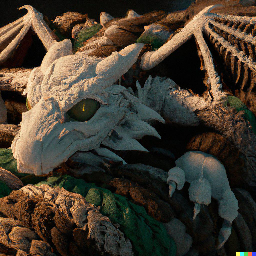
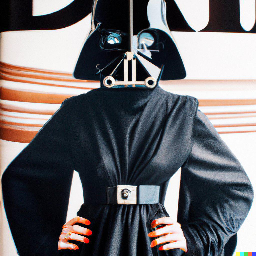
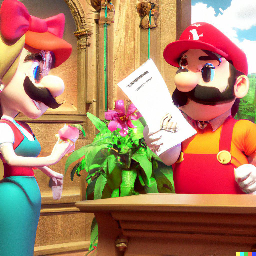
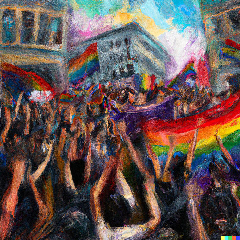
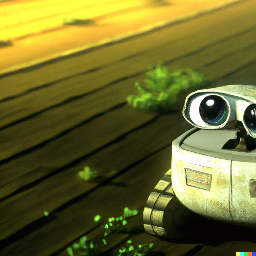
...
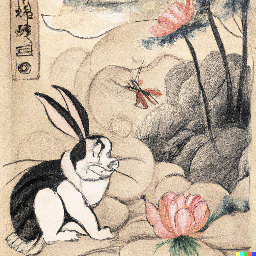
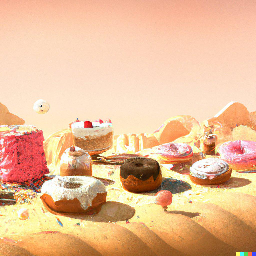
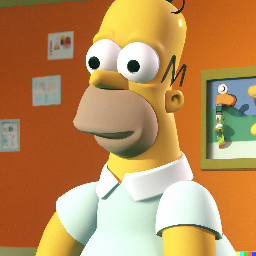
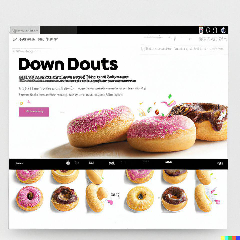
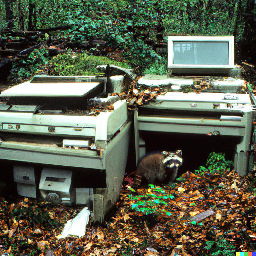

In [ ]:
dalle_images.explore()

In [ ]:
# get the vector of the image
def get_images_features_vector(dataset, feature="image", model_name='resnet-50'):
    ptModel = tc.toolkits._pre_trained_models.ResNetImageClassifier()
    feature_extractor = tc.toolkits._image_feature_extractor._create_feature_extractor(model_name)
    extracted_features = tc.SFrame({'__image_features__': feature_extractor.extract_features(dataset, feature)})
    dataset['image_features'] = extracted_features['__image_features__']
    return dataset

dalle_images = get_images_features_vector(dalle_images)
dalle_images

In [ ]:
similarity_dalle = tc.image_similarity.create(dalle_images)

Starting brute force nearest neighbors model training.

Validating distance components.

Initializing model data.

Initializing distances.

Done.

In [ ]:
similarity_graph = similarity_dalle.similarity_graph(k=5)

Starting blockwise similarity graph construction.

max rows per data block: 6207

number of reference data blocks: 2

+---------+-------------+--------------+

| # Pairs | % Complete. | Elapsed Time |

+---------+-------------+--------------+

| 28322   | 66.6667     | 69.561ms     |

| 42483   | 100         | 99.732ms     |

+---------+-------------+--------------+

In [ ]:
# create graph between similar images
import networkx as nx
g = nx.Graph()
for v in similarity_graph.vertices['__id']:
    g.add_node(v, attr_dict={'path':dalle_images[v]['path']})
for e in similarity_graph.edges:
    g.add_edge(e["__src_id"], e["__dst_id"])
nx.info(g)

'Graph with 238 nodes and 1020 edges'

In [ ]:
# to display the graph, save the images as nodes, using local serva (wow, it's was exhausting...)
n_csv = ["id,path"]
for n in g.nodes():
    path = g.nodes[n]['attr_dict']['path'].split("convert/")[1]
    path = f"http://127.0.0.1:8000/{path}" #ask me in class why I using http:// :)
    n_csv.append(f"{n},{path}")
open('./dalle_vertices.csv', "w").write("\n".join(n_csv))
e_csv = ["src,dst"]
for e1,e2 in g.edges():
    e_csv.append(f"{e1},{e2}")
open('./dalle_edges.csv', "w").write("\n".join(e_csv))

nx.info(g)


'Graph with 238 nodes and 1020 edges'

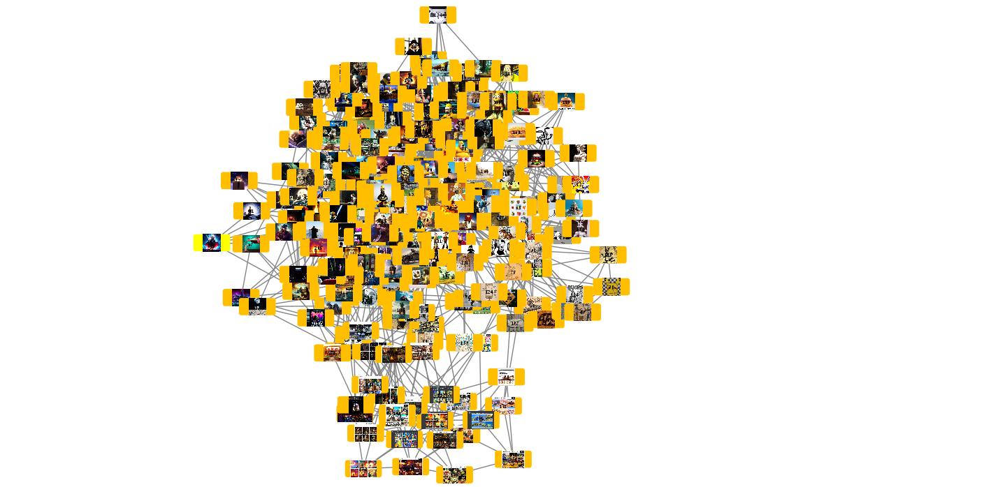

In [ ]:
from IPython.display import Image
Image("./graph.gml.png")

Now, place the images on coordinate, to see similarity

In [ ]:
# generate (x,y) pair for each image
X = []
for v in dalle_images['image_features']:
    X.append(v)
X = np.array(X)
print("Computed X: ", X.shape)
X_embedded = TSNE(n_components=2,perplexity=100, n_iter=5000, verbose=2).fit_transform(X)
print("Computed t-SNE", X_embedded.shape)
df = pd.DataFrame(columns=['x', 'y', 'class'])
df['x'], df['y'] = X_embedded[:,0], X_embedded[:,1]

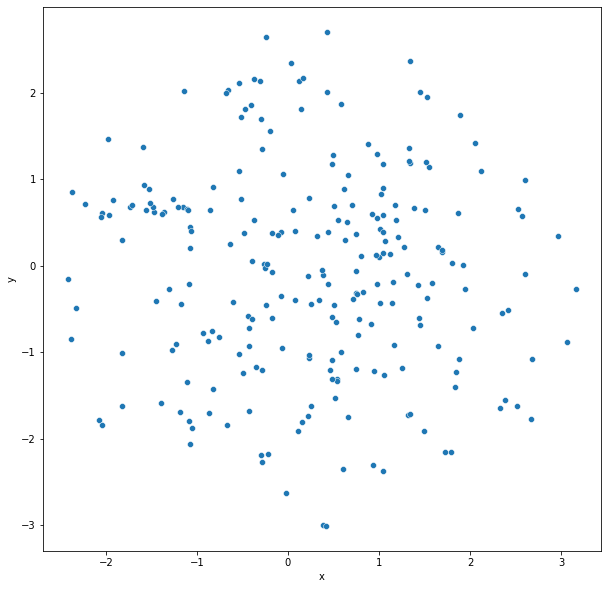

In [ ]:
plt.figure(figsize=(10,10))
sns.scatterplot(x="x", y="y", data=df)

As you can see in the graph and the figure above, it is difficult to find similarities between images, and it seems that each image is actually created from a different text. This is amazing! Dalle-2 generate images so different from each other!

___
We will now try to detect the objects in the image, and according to this understand for each image its subject

In [ ]:
# relaod the sf
dalle_images = tc.SFrame.read_csv('./with_feature_dalle.csv')
dalle_images

Finished parsing file /content/with_feature_dalle.csv

Parsing completed. Parsed 100 lines in 0.13329 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,array]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/with_feature_dalle.csv

Parsing completed. Parsed 238 lines in 0.09537 secs.

path,image,image_features
/content/Question_3/dalle-images/convert/1.jpg ...,Height: 1024 Width: 1024,"[0.238507, 0.0, 0.320949,0.672525, 0.277811, ..."
/content/Question_3/dalle-images/convert/10.jpg ...,Height: 1024 Width: 1024,"[0.670339, 0.0, 1.50273,1.93382, 0.200387, ..."
/content/Question_3/dalle-images/convert/100.jpg ...,Height: 1024 Width: 1024,"[0.370795, 0.0, 1.59056,1.65283, 0.444254, ..."
/content/Question_3/dalle-images/convert/101.jpg ...,Height: 960 Width: 960,"[0.60409, 0.0, 0.766837,0.969067, 0.831493, ..."
/content/Question_3/dalle-images/convert/102.jpg ...,Height: 1024 Width: 1024,"[0.0132824, 0.0,0.506973, 0.511017, ..."
/content/Question_3/dalle-images/convert/103.jpg ...,Height: 1024 Width: 1024,"[0.124335, 0.0, 0.509739,0.574394, 0.345859, ..."
/content/Question_3/dalle-images/convert/104.jpg ...,Height: 1024 Width: 1024,"[0.171188, 0.0, 0.286605,0.801783, 0.160321, ..."
/content/Question_3/dalle-images/convert/105.jpg ...,Height: 1024 Width: 1024,"[0.172475, 0.0, 1.27835,1.33026, 0.419442, ..."
/content/Question_3/dalle-images/convert/106.jpg ...,Height: 626 Width: 626,"[0.0978405, 0.0,0.172751, 0.296016, ..."
/content/Question_3/dalle-images/convert/107.jpg ...,Height: 1024 Width: 1024,"[0.40268, 0.0, 0.299933,0.356817, 0.116367, ..."


In [ ]:
dalle_images['name'] = dalle_images['path'].apply(lambda x: x.split("convert/")[1])

In [ ]:
# image detection

!mkdir ./models
!mkdir ./Question_3/dalle-images/detect
!wget -O ./models/resnet50_coco_best_v2.0.1.h5 https://github.com/OlafenwaMoses/ImageAI/releases/download/essentials-v5/resnet50_coco_best_v2.1.0.h5
execution_path = os.getcwd()
model_path = os.path.join(execution_path, "models/resnet50_coco_best_v2.0.1.h5")
detector = ObjectDetection()
detector.setModelTypeAsRetinaNet()
detector.setModelPath(model_path)
detector.loadModel()

def detect_image(path):
  name = path.split("convert/")[1]
  try:
    detections = detector.detectObjectsFromImage(input_image=path,
                                                output_image_path=f"./Question_3/dalle-images/detect/{name}",
                                                minimum_percentage_probability=20
                                                )
  except:
    return []
  objects = []
  for eachObject in detections:
      objects.append(str(eachObject["name"]))
  return Counter(objects)

mkdir: cannot create directory ‘./models’: File exists
mkdir: cannot create directory ‘./Question_3/dalle-images/detect’: File exists


In [ ]:
# image detection in batch of 10 (it didn't work for me otherwise)
dic = {}
for i in range (230,240):
  path = dalle_images[i]['path']
  dic[i] = detect_image(path)


In [ ]:
# add for each image the objects apears in
dalle_images.add_column(list(dic.values()), column_name='objects', inplace=True)
dalle_images

In [ ]:
# save the corrent sf
dalle_images.export_csv('./image_with_det.csv')

In [ ]:
# create union dictionary of objects
union_dict = {}
for k in dic:
  if dic[k]:
    for word in dic[k]:
      if word in union_dict:
        union_dict[word] += dic[k][word]
      else:
        union_dict[word] = 0
union_dict

{'airplane': 16,
 'apple': 13,
 'backpack': 25,
 'banana': 51,
 'baseball bat': 9,
 'baseball glove': 2,
 'bear': 3,
 'bed': 17,
 'bench': 18,
 'bicycle': 11,
 'bird': 64,
 'boat': 36,
 'book': 20,
 'bottle': 25,
 'bowl': 38,
 'broccoli': 4,
 'bus': 12,
 'cake': 56,
 'car': 64,
 'carrot': 4,
 'cat': 28,
 'cell phone': 23,
 'chair': 122,
 'clock': 16,
 'couch': 13,
 'cow': 11,
 'cup': 20,
 'dining table': 66,
 'dog': 32,
 'donut': 49,
 'elephant': 9,
 'fire hydrant': 13,
 'fork': 7,
 'frisbee': 5,
 'giraffe': 2,
 'hair dryer': 2,
 'handbag': 28,
 'horse': 15,
 'hot dog': 1,
 'keyboard': 2,
 'kite': 16,
 'knife': 17,
 'laptop': 12,
 'microwave': 2,
 'motorcycle': 53,
 'mouse': 8,
 'orange': 6,
 'oven': 5,
 'parking meter': 7,
 'person': 601,
 'pizza': 8,
 'potted plant': 16,
 'refrigerator': 1,
 'remote': 9,
 'sandwich': 13,
 'scissors': 21,
 'sheep': 9,
 'sink': 5,
 'skateboard': 17,
 'skis': 4,
 'snowboard': 0,
 'spoon': 9,
 'sports ball': 12,
 'stop sign': 2,
 'suitcase': 20,
 'surfbo

## Results

First, Let's take a look on the object apears in the images:

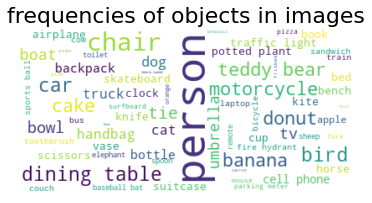

In [ ]:
wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate_from_frequencies(union_dict)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title("frequencies of objects in images", fontsize=22)
plt.show()

<AxesSubplot:title={'center':'Number of images per object'}, xlabel='image', ylabel='objects'>

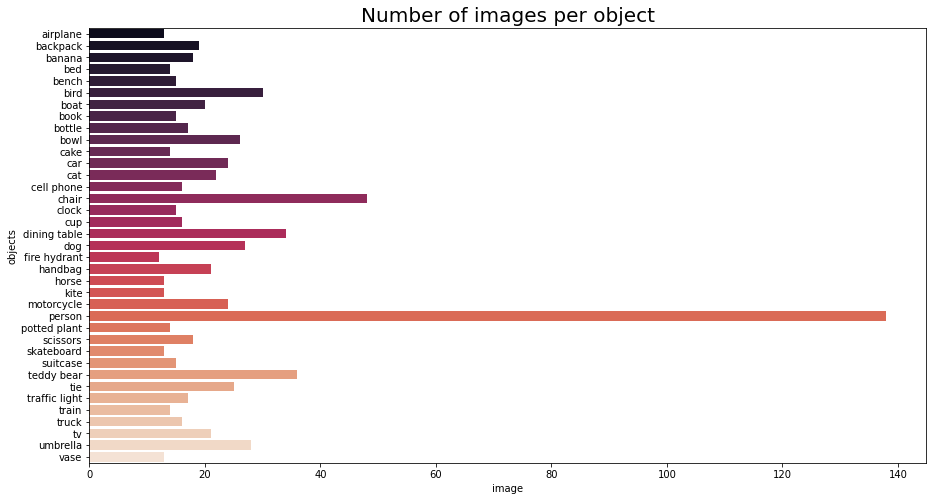

In [ ]:
# count object over all the images

object_stack = dalle_images.to_dataframe()
object_stack =object_stack[object_stack['objects'].map(len) > 0]
object_stack = object_stack.explode('objects').reset_index(drop=True)
count_obj = object_stack.groupby('objects').count().reset_index()
count_obj = count_obj[count_obj['image'] > 10]
plt.figure(figsize=(15,8))
plt.title("Number of images per object", fontsize=20)
sns.barplot(y=count_obj['objects'], x=count_obj["image"], palette="rocket")

Now, using SpyCy, we want to fine the topic of the images, using its title

In [ ]:
image_desc = tweets_dalle2[['Tweet Id', 'Text']]
image_desc.head(2)

,Tweet Id,Text
0,1544082407711772672,More of Homer Simpson as the first man on the ...
1,1544073855437881344,Homer Simpson as the first man on the moon mad...


In [ ]:
# stemming (lemmatization)
lemmatizer = WordNetLemmatizer()

sf  = tc.SFrame(image_desc)
docs = sf['Text'].apply(lambda txt: [lemmatizer.lemmatize(w) for w in re.findall(r"(\w+)", txt) if not w.startswith('#') and not w.startswith('http') and not len(w)<3])

# converting the data to work in Gensim
id2word = corpora.Dictionary(docs)
corpus = [id2word.doc2bow(text) for text in docs]


In [ ]:
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=20,
                                           update_every=0,
                                           chunksize=500,
                                           alpha='auto',
                                           per_word_topics=True)

In [ ]:
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, corpus, id2word)
vis

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
19     0.036754 -0.051457       1        1  11.977914
4      0.107781 -0.065355       2        1   9.265417
17     0.062384  0.017163       3        1   7.371959
0      0.110434  0.019785       4        1   6.441357
13     0.020185 -0.019388       5        1   6.091514
18    -0.088659 -0.141157       6        1   5.811380
10     0.078731  0.081638       7        1   5.497704
15    -0.019427 -0.058974       8        1   5.435031
2     -0.039791  0.088106       9        1   5.375366
11     0.043807  0.053416      10        1   5.005661
14     0.023416 -0.019996      11        1   4.759249
12    -0.068099  0.035510      12        1   4.675554
8     -0.017864  0.073149      13        1   4.143142
3      0.011206 -0.052542      14        1   4.097719
7      0.018806 -0.055167      15        1   3.979618
16    -0.112782  0.024950      16        1   3.254431
6      0.035505 -0.012322      17        1   2.726508
5     -0.111824  0.012733      18        1   1.394219
9     -0.068146  0.017266      19        1   1.367985
1     -0.022416  0.052641      20        1   1.328274, topic_info=       Term       Freq       Total Category  logprob  loglift
206  Thread  24.000000   24.000000  Default  30.0000  30.0000
7      made  41.000000   41.000000  Default  29.0000  29.0000
184   still  35.000000   35.000000  Default  28.0000  28.0000
51      art  17.000000   17.000000  Default  27.0000  27.0000
10      the  56.000000   56.000000  Default  26.0000  26.0000
..      ...        ...         ...      ...      ...      ...
7      made   0.404761   41.915164  Topic20  -4.4274  -0.3188
4     dalle   1.175734  151.788863  Topic20  -3.3611  -0.5393
11     with   0.404761   49.669961  Topic20  -4.4274  -0.4886
10      the   0.019274   56.524886  Topic20  -7.4719  -3.6624
1     Homer   0.019274   23.962650  Topic20  -7.4719  -2.8042

[1030 rows x 6 columns], token_table=      Topic      Freq        Term
term                             
448      16  0.802449  04VpyaTZKr
528       7  0.679490  0MQfzjFHFD
63        6  0.668547  0UxBXF79ex
721      13  0.765077       100mm
850       7  0.679490        1561
...     ...       ...         ...
40        6  0.358116         you
40        8  0.119372         you
40       13  0.119372         you
486      13  0.765077  znpwNOkKWZ
281      14  0.749436      zoomin

[1117 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[20, 5, 18, 1, 14, 19, 11, 16, 3, 12, 15, 13, 9, 4, 8, 17, 7, 6, 10, 2])

As we can see from all the results we showed above - the subjects of the pictures are different and varied. Lots of pictures of cartoons (Simpson, Minions), pictures of foods, and especially of people

Finally, we would like to see if the images look like a photo or a painting. For this purpose, a claasifier model was built with [data from kaggle](https://www.kaggle.com/datasets/iiplutocrat45ii/painting-vs-photograph-classification-dataset), with the help of which we predicted the type of images in our database

In [ ]:
! kaggle datasets download -d iiplutocrat45ii/painting-vs-photograph-classification-dataset -p /content/Question_3/Kaggle/
!unzip /content/Question_3/Kaggle/*.zip  -d /content/Question_3/Kaggle/

In [ ]:
# load images and add class column
DATASET_PATH = "/content/Question_3/Kaggle/"
train_data = tc.image_analysis.load_images(f"{DATASET_PATH}train/")
train_data['class'] = train_data['path'].apply(lambda p: p.split('/')[-2])
test_data = tc.image_analysis.load_images(f"{DATASET_PATH}/test/", with_path=True)
test_data['class'] = test_data['path'].apply(lambda p: p.split('/')[-2])
test_data.materialize()
train_data.materialize()

In [ ]:
# build the model
cls = tc.image_classifier.create(train_data, target='class')

Performing feature extraction on resized images...
Completed   64/7041
Completed  128/7041
Completed  192/7041
Completed  256/7041
Completed  320/7041
Completed  384/7041
Completed  448/7041
Completed  512/7041
Completed  576/7041
Completed  640/7041
Completed  704/7041
Completed  768/7041
Completed  832/7041
Completed  896/7041
Completed  960/7041
Completed 1024/7041
Completed 1088/7041
Completed 1152/7041
Completed 1216/7041
Completed 1280/7041
Completed 1344/7041
Completed 1408/7041
Completed 1472/7041
Completed 1536/7041
Completed 1600/7041
Completed 1664/7041
Completed 1728/7041
Completed 1792/7041
Completed 1856/7041
Completed 1920/7041
Completed 1984/7041
Completed 2048/7041
Completed 2112/7041
Completed 2176/7041
Completed 2240/7041
Completed 2304/7041
Completed 2368/7041
Completed 2432/7041
Completed 2496/7041
Completed 2560/7041
Completed 2624/7041
Completed 2688/7041
Completed 2752/7041
Completed 2816/7041
Completed 2880/7041
Completed 2944/7041
Completed 3008/7041
Completed

Logistic regression:

--------------------------------------------------------

Number of examples          : 6688

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 2048

Number of coefficients      : 2049

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 4        | 0.250000  | 1.118105     | 0.728319          | 0.781870            |

| 1         | 6        | 0.250000  | 2.077041     | 0.793361          | 0.821530            |

| 2         | 9        | 1.250000  | 3.338537     | 0.812500          | 0.801700            |

| 3         | 15       | 5.960261  | 5.451031     | 0.826406          | 0.818697            |

| 4         | 17       | 4.922606  | 6.393341     | 0.834928          | 0.841360            |

| 9         | 26       | 1.355023  | 10.988700    | 0.900568          | 0.892351            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

Performing feature extraction on resized images...
Completed   64/2173
Completed  128/2173
Completed  192/2173
Completed  256/2173
Completed  320/2173
Completed  384/2173
Completed  448/2173
Completed  512/2173
Completed  576/2173
Completed  640/2173
Completed  704/2173
Completed  768/2173
Completed  832/2173
Completed  896/2173
Completed  960/2173
Completed 1024/2173
Completed 1088/2173
Completed 1152/2173
Completed 1216/2173
Completed 1280/2173
Completed 1344/2173
Completed 1408/2173
Completed 1472/2173
Completed 1536/2173
Completed 1600/2173
Completed 1664/2173
Completed 1728/2173
Completed 1792/2173
Completed 1856/2173
Completed 1920/2173
Completed 1984/2173
Completed 2048/2173
Completed 2112/2173
Completed 2173/2173


{'accuracy': 0.0, 'auc': 0.0, 'confusion_matrix': Columns:
 	target_label	str
 	predicted_label	str
 	count	int
 
 Rows: 2
 
 Data:
 +--------------+-----------------+-------+
 | target_label | predicted_label | count |
 +--------------+-----------------+-------+
 |     test     |      photos     |  1918 |
 |     test     |     painting    |  255  |
 +--------------+-----------------+-------+
 [2 rows x 3 columns], 'f1_score': 0.0, 'log_loss': 34.538776394911054, 'precision': 0.0, 'recall': 0.0, 'roc_curve': Columns:
 	threshold	float
 	fpr	float
 	tpr	float
 	p	int
 	n	int
 
 Rows: 1001
 
 Data:
 +-----------+-----+-----+---+---+
 | threshold | fpr | tpr | p | n |
 +-----------+-----+-----+---+---+
 |    0.0    | nan | nan | 0 | 0 |
 |   0.001   | nan | nan | 0 | 0 |
 |   0.002   | nan | nan | 0 | 0 |
 |   0.003   | nan | nan | 0 | 0 |
 |   0.004   | nan | nan | 0 | 0 |
 |   0.005   | nan | nan | 0 | 0 |
 |   0.006   | nan | nan | 0 | 0 |
 |   0.007   | nan | nan | 0 | 0 |
 |   0.008 

In [ ]:
# make the prediction!
dalle_data = tc.image_analysis.load_images("/content/Question_3/dalle-images/convert")
dalle_data['prediction'] = cls.predict(dalle_data)

In [ ]:
dalle_data

path,image,prediction
/content/Question_3/dalle-images/convert/1.jpg ...,Height: 1024 Width: 1024,photos
/content/Question_3/dalle-images/convert/10.jpg ...,Height: 1024 Width: 1024,photos
/content/Question_3/dalle-images/convert/100.jpg ...,Height: 1024 Width: 1024,photos
/content/Question_3/dalle-images/convert/101.jpg ...,Height: 960 Width: 960,painting
/content/Question_3/dalle-images/convert/102.jpg ...,Height: 1024 Width: 1024,photos
/content/Question_3/dalle-images/convert/103.jpg ...,Height: 1024 Width: 1024,painting
/content/Question_3/dalle-images/convert/104.jpg ...,Height: 1024 Width: 1024,photos
/content/Question_3/dalle-images/convert/105.jpg ...,Height: 1024 Width: 1024,photos
/content/Question_3/dalle-images/convert/106.jpg ...,Height: 626 Width: 626,painting
/content/Question_3/dalle-images/convert/107.jpg ...,Height: 1024 Width: 1024,painting


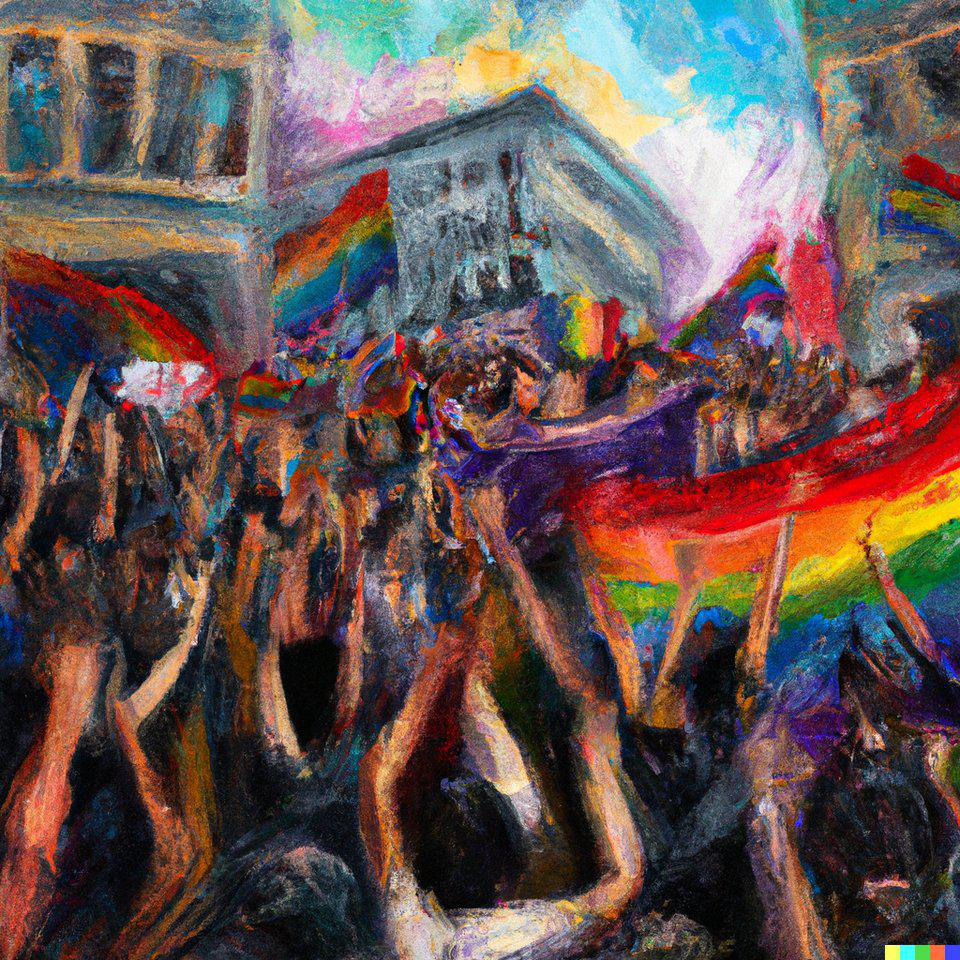

In [ ]:
dalle_data[3]['image']  # need to be painting - we right!

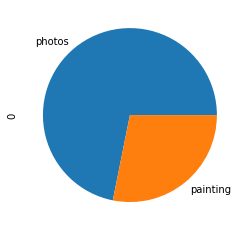

In [ ]:
d = pd.DataFrame(dalle_data['prediction'])
d[0].value_counts().plot(kind='pie')